1.Preparing Dataset

In [ ]:
import os

def list_deepest_child_folders(folder_path):
    """
    Recursively lists the deepest child folders (those without any subfolders) with their full paths from the parent folder.
    """
    # Initialize a list to store the deepest child folders
    deepest_child_folders = []

    # Get the list of items (files and folders) in the parent folder
    items = os.listdir(folder_path)

    # Iterate over each item
    for item in items:
        # Create the full path of the item
        item_path = os.path.join(folder_path, item)

        # Check if the item is a folder
        if os.path.isdir(item_path):
            # Recursively check if the folder has any subfolders
            subfolders = [f for f in os.listdir(item_path) if os.path.isdir(os.path.join(item_path, f))]
            if not subfolders:
                # If the folder does not have any subfolders, add it to the list of deepest child folders
                deepest_child_folders.append(item_path)
            else:
                # If the folder has subfolders, recursively add the deepest child folders to the list
                deepest_child_folders.extend(list_deepest_child_folders(item_path))

    # Return the list of deepest child folders
    return deepest_child_folders

# Specify the parent folder path
drive_folder_path = '/content/drive/MyDrive/Cityscape_Dataset'

# Get the list of deepest child folders with their full paths from the parent folder
data_paths = list_deepest_child_folders(drive_folder_path)

# Print the list of deepest child folders
for path in data_paths:
    print(path)


/content/drive/MyDrive/Cityscape_Dataset/images_prepped_train
/content/drive/MyDrive/Cityscape_Dataset/annotations_prepped_train
/content/drive/MyDrive/Cityscape_Dataset/annotations_prepped_test
/content/drive/MyDrive/Cityscape_Dataset/images_prepped_test
/content/drive/MyDrive/Cityscape_Dataset/train
/content/drive/MyDrive/Cityscape_Dataset/test


In [ ]:
import os
import shutil

# Create the directory if it does not exist
test_dir = '/content/cityscapes/test/data'


source = os.path.join(drive_folder_path, '/content/drive/MyDrive/Cityscape_Dataset/images_prepped_test')
shutil.copytree(source, test_dir)

test_masks_dir = '/content/cityscapes/test/masks'

source = source = os.path.join(drive_folder_path, '/content/drive/MyDrive/Cityscape_Dataset/annotations_prepped_test')
shutil.copytree(source, test_masks_dir)


'/content/cityscapes/test/masks'

In [ ]:
# Create the directory if it does not exist
train_dir = '/content/cityscapes/train/data'


source = os.path.join(drive_folder_path, '/content/drive/MyDrive/Cityscape_Dataset/images_prepped_train')
shutil.copytree(source, train_dir)

train_masks_dir = '/content/cityscapes/train/masks'

source = source = os.path.join(drive_folder_path, '/content/drive/MyDrive/Cityscape_Dataset/annotations_prepped_train')
shutil.copytree(source, train_masks_dir)


'/content/cityscapes/train/masks'

2.Resize Function

In [ ]:
import torchvision.transforms.functional as TF

class ResizeTransform:
  def __init__(self, size):
    """
    size: Desired output size of the image and mask as a tuple (height, width)
    """
    self.size = size

  def __call__(self, image, mask):
    # Resize both image and mask
    image = TF.resize(image, self.size)
    mask = TF.resize(mask, self.size)
    return image, mask


In [ ]:
import random
import torchvision.transforms.functional as TF
import numpy as np

class SegmentationTransform:
  def __init__(self, input_size, output_size, rotation_range=(-15, 15)):
    self.input_size = input_size
    self.output_size = output_size
    self.rotation_range = rotation_range

  def __call__(self, img, mask):
    C, H, W = img.shape

    # Random rotation
    angle = random.uniform(*self.rotation_range)
    img = TF.rotate(img, angle)
    mask = TF.rotate(mask, angle)

    # Calculate new dimensions of the rotated image
    new_h, new_w = img.shape[1], img.shape[2]

    # Calculate cropping size to remove any black borders
    crop_h = int(new_h / np.sqrt(2))
    crop_w = int(new_w / np.sqrt(2))

    # Ensure crop size is not larger than original
    crop_h = min(crop_h, H)
    crop_w = min(crop_w, W)

    # Calculate top and left coordinates for cropping
    top = (new_h - crop_h) // 2
    left = (new_w - crop_w) // 2

    # Perform the crop
    img = img[:, top:top + crop_h, left:left + crop_w]
    mask = mask[:, top:top + crop_h, left:left + crop_w]

    # Resize both image and mask to the final output size
    img = TF.resize(img, self.output_size)
    mask = TF.resize(mask, self.output_size)

    # Random horizontal flip
    if random.random() > 0.5:
      img = TF.hflip(img)
      mask = TF.hflip(mask)

    return img, mask


3.Transform Image

In [ ]:
import os
import torch
from torch.utils.data import Dataset
from torchvision.transforms import v2
from torchvision.io import read_image


class CityscapesDataset(Dataset):
  def __init__(self, root_dir, transform=None):
    self.root_dir = root_dir
    self.transform = transform
    self.mask_dir = os.path.join(root_dir, 'masks')
    self.images_dir = os.path.join(root_dir, 'data')
    self.image_names = os.listdir(self.images_dir)

  def __len__(self):
    return len(self.image_names)

  def __getitem__(self, idx):
    image_name = self.image_names[idx]
    image_path = os.path.join(self.images_dir, image_name)
    mask_path = os.path.join(self.mask_dir, image_name)

    image = read_image(image_path)
    mask = read_image(mask_path)

    if self.transform:
      image, mask = self.transform(image, mask)


    tensor_transform = v2.Compose([
        v2.ToDtype(dtype=torch.float32, scale=True),
        v2.ToPureTensor()
    ])

    image = tensor_transform(image)

    return image, mask

In [ ]:
train_dataset = CityscapesDataset(root_dir='/content/cityscapes/train', transform=SegmentationTransform(input_size=(300, 300), output_size=(512,512)))
test_dataset = CityscapesDataset(root_dir='/content/cityscapes/test', transform=ResizeTransform((512, 512)))

print(f'[INFO] Lenght of train dataset: {len(train_dataset)}')
print(f'[INFO] Lenght of test dataset: {len(test_dataset)}')

[INFO] Lenght of train dataset: 367
[INFO] Lenght of test dataset: 101


4.Converting Mask

In [ ]:
import numpy as np
all_classes = set()

for _, mask in train_dataset:
  # Assuming mask is a tensor, numpy array, or similar
  unique_values = np.unique(mask.numpy())  # Convert mask to NumPy array and find unique values
  all_classes.update(unique_values)  # Add unique values to the set

# Convert the set of unique mask values to a flattened array
all_classes = np.array(list(all_classes))
NUM_CLASSES = len(all_classes)
print(f"[INFO] Unique mask values across all datasets:", all_classes)
print(f"[INFO] Length of NUM_CLASSES:", NUM_CLASSES)


[INFO] Unique mask values across all datasets: [ 0  1  2  3  4  5  6  7  8  9 10 11]
[INFO] Length of NUM_CLASSES: 12


5.Set Batch Size

In [ ]:
import os
from torch.utils.data import DataLoader

NUM_WORKER = os.cpu_count()
# Create the DataLoader
BATCH_SIZE = 8
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKER)
test_dataloader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKER)


print(f'[INFO] Lenght of train dataloader: {len(train_dataloader)} of {BATCH_SIZE} batches')
print(f'[INFO] Lenght of test dataloader: {len(test_dataloader)} of {BATCH_SIZE} batches')


[INFO] Lenght of train dataloader: 46 of 8 batches
[INFO] Lenght of test dataloader: 13 of 8 batches


6.Installing Torch Info

In [ ]:
# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

[INFO] Couldn't find torchinfo... installing it.


7A.Set Model (FCN 8S - Resnet)

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN8s_ResNet(nn.Module):
  def __init__(self, num_classes):
    super(FCN8s_ResNet, self).__init__()
    # Load pre-trained ResNet model
    weights = models.ResNet50_Weights.DEFAULT
    resnet50 = models.resnet50(weights=weights)

    self.features = nn.Sequential(*list(resnet50.children())[:-2])


    # Classifier that includes convolution layers
    self.classifier = nn.Sequential(
      nn.Conv2d(2048, 4096, kernel_size=7, padding=3),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, 4096, kernel_size=1),
      nn.ReLU(inplace=True),
      nn.Dropout2d(),
      nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    # Convert feature maps from ResNet backbone to have `num_classes` channels
    self.score_pool4 = nn.Conv2d(1024, num_classes, 1)  # layer from pool4 (res5c)
    self.score_pool3 = nn.Conv2d(512, num_classes, 1)  # layer from pool3 (res4f)

    # Upsampling layers
    self.upsample2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
    self.upsample8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)

  def forward(self, x):
    # Encoder (ResNet backbone)
    x3 = self.features[:6](x)  # Output from layer 3 (res4f)
    x4 = self.features[6:7](x3)  # Output from layer 4 (res5c)
    x5 = self.features[7:](x4)  # Final layer output

    # Fully Convolutional Classifier
    x = self.classifier(x5)

    # Upsampling and skip connections
    x = self.upsample2x(x)  # Upsample to match pool4 dimensions
    pool4 = self.score_pool4(x4)  # Reduce channel dimensions of pool4 to match x
    x = x + pool4

    x = self.upsample2x(x)  # Upsample to match pool3 dimensions
    pool3 = self.score_pool3(x3)  # Reduce channel dimensions of pool3 to match x
    x = x + pool3

    x = self.upsample8x(x)  # Final upsampling to original image size

    return x


In [ ]:
model_fcn8s_restnet = FCN8s_ResNet(num_classes=NUM_CLASSES)
summary(model=model_fcn8s_restnet,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 152MB/s]


Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
FCN8s_ResNet (FCN8s_ResNet)                   [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─Sequential (features)                       --                   --                   --                   True
│    └─Conv2d (0)                             [1, 3, 512, 512]     [1, 64, 256, 256]    9,408                True
│    └─BatchNorm2d (1)                        [1, 64, 256, 256]    [1, 64, 256, 256]    128                  True
│    └─ReLU (2)                               [1, 64, 256, 256]    [1, 64, 256, 256]    --                   --
│    └─MaxPool2d (3)                          [1, 64, 256, 256]    [1, 64, 128, 128]    --                   --
│    └─Sequential (4)                         [1, 64, 128, 128]    [1, 256, 128, 128]   --                   True
│    │    └─Bottleneck (0)                    [1, 64, 128, 128]    [1, 256, 128, 128]  

7B.Set Model (FCN 8S - VGG)

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class FCN8s_VGG(nn.Module):
  def __init__(self, num_classes):
    super(FCN8s_VGG, self).__init__()
    # Load pre-trained VGG model
    weights = models.VGG16_Weights.DEFAULT
    vgg16 = models.vgg16(weights=weights)

    # Retain the convolutional part of VGG16 and discard the fully connected layers
    vgg16_features = list(vgg16.features.children())
    self.features = nn.Sequential(*vgg16_features)

    # Freeze the features
    # for param in self.features.parameters():
    #   param.requires_grad = False

    self.classifier = nn.Sequential(
        nn.Conv2d(512, 4096, kernel_size=7, padding=3),
        nn.ReLU(inplace=True),
        nn.Dropout2d(),
        nn.Conv2d(4096, 4096, kernel_size=1),
        nn.ReLU(inplace=True),
        nn.Dropout2d(),
        nn.Conv2d(4096, num_classes, kernel_size=1)
    )

    # Convert feature maps from the VGG backbone to have `num_classes` channels
    self.score_pool4 = nn.Conv2d(512, num_classes, 1)  # layer from pool4
    self.score_pool3 = nn.Conv2d(256, num_classes, 1)  # layer from pool3

    # Upsampling layers
    self.upsample2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
    self.upsample8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)

  def forward(self, x):
    # Encoder (VGG backbone)
    x3 = self.features[:17](x)  # Layer 17 output (pool3)
    x4 = self.features[17:24](x3)  # Layer 24 output (pool4)
    x5 = self.features[24:](x4)  # Final layer output

    # Fully Convolutional Classifier
    x = self.classifier(x5)

    # Upsampling and skip connections
    x = self.upsample2x(x)  # Upsample to match pool4 dimensions
    pool4 = self.score_pool4(x4)  # Reduce channel dimensions of pool4 to match x
    x = x + pool4

    x = self.upsample2x(x)  # Upsample to match pool3 dimensions
    pool3 = self.score_pool3(x3)  # Reduce channel dimensions of pool3 to match x
    x = x + pool3

    x = self.upsample8x(x)  # Final upsampling to original image size

    return x


In [ ]:
model_fcn8s_vgg = FCN8s_VGG(num_classes=NUM_CLASSES)
summary(model=model_fcn8s_vgg,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 188MB/s]


Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
FCN8s_VGG (FCN8s_VGG)                    [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─Sequential (features)                  --                   --                   --                   True
│    └─Conv2d (0)                        [1, 3, 512, 512]     [1, 64, 512, 512]    1,792                True
│    └─ReLU (1)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─Conv2d (2)                        [1, 64, 512, 512]    [1, 64, 512, 512]    36,928               True
│    └─ReLU (3)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    └─MaxPool2d (4)                     [1, 64, 512, 512]    [1, 64, 256, 256]    --                   --
│    └─Conv2d (5)                        [1, 64, 256, 256]    [1, 128, 256, 256]   73,856               True
│    └─ReLU (6)     

8.Make DiceLoss Class (used to evaluate the performance of machine learning models for segmentation Image)

In [ ]:
import torch
import torch.nn as nn

class DiceLoss(nn.Module):
  def __init__(self, smooth=1e-3):
    super(DiceLoss, self).__init__()
    self.smooth = smooth

  def forward(self, outputs, targets):
    # Apply softmax to the outputs to get class probabilities
    outputs = torch.softmax(outputs, dim=1)
    # One-hot encode targets
    targets = torch.nn.functional.one_hot(targets, num_classes=outputs.shape[1]).permute(0, 3, 1, 2).float()

    intersection = torch.sum(outputs * targets, dim=(0, 2, 3))
    cardinality = torch.sum(outputs + targets, dim=(0, 2, 3))

    dice_score = (2. * intersection + self.smooth) / (cardinality + self.smooth)
    # We use '1 - dice_score' because we want to minimize the loss
    return 1 - dice_score.mean()  # Average across all classes



In [ ]:
import torch
from torch import nn
from torch.utils.data import DataLoader
from torch.cuda.amp import autocast
from tqdm import tqdm


def train_step(model: nn.Module,
               dataloader: DataLoader,
               loss_fn: DiceLoss,  # Specify that loss_fn is expected to be DiceLoss
               optimizer: torch.optim.Optimizer,
               scaler: torch.cuda.amp.GradScaler,
               device: torch.device) -> float:

  model.train()
  total_loss = 0.0
  valid_batches = 0

  for data, targets in tqdm(dataloader, desc="Training", leave=False):
    data, targets = data.to(device), targets.to(device).squeeze(1).long()
    optimizer.zero_grad()
    with autocast():
      outputs = model(data)
      loss = loss_fn(outputs, targets)
      if torch.isnan(loss):
        print("\n[INFO] NaN detected in loss, skipping update.")
        continue  # Skip this batch

    scaler.scale(loss).backward()
    scaler.step(optimizer)
    scaler.update()



    total_loss += loss.item() * data.size(0)
    valid_batches += 1

  average_loss = total_loss / sum(d.size(0) for d, _ in dataloader if d.size(0)) if valid_batches > 0 else float('nan')

  return average_loss

In [ ]:
import torch
from torch import nn
from torch.utils.data import DataLoader
from tqdm import tqdm
import numpy as np


def test_step(model: nn.Module,
              dataloader: DataLoader,
              loss_fn: DiceLoss,  # Specify that loss_fn is expected to be DiceLoss
              device: torch.device) -> float:
  model.eval()
  total_loss = 0.0
  with torch.inference_mode():
    for data, targets in tqdm(dataloader, desc="Testing", leave=False):
      data, targets = data.to(device), targets.to(device).squeeze(1).long()
      outputs = model(data)
      loss = loss_fn(outputs, targets)
      total_loss += loss.item() * data.size(0)
  avg_loss = total_loss / len(dataloader.dataset)
  return avg_loss

9.Set engine and measurement parameter

In [ ]:
import torch
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import time
from datetime import datetime
from typing import Dict
import os

def run_training(
  model: nn.Module,
  train_loader: DataLoader,
  test_loader: DataLoader,
  loss_fn: nn.Module,
  optimizer: torch.optim.Optimizer,
  scaler: torch.cuda.amp.GradScaler,
  experiment: Dict,
  writer: SummaryWriter,
  device: torch.device,
  num_classes: int):


#   EXPERIMENT = {
#     "experiment_name": experiment_name,
#     "model_name": model_name,
#     "experiment_date": timestamp,
#     "last_dice": 0.0,
#     "train_until": train_until_epoch,
#     "last_best_epoch": last_best_epoch,
#     "num_epochs": train_until_epoch - last_best_epoch,
#     "checkpoint_dir": checkpoint_dir
# }

  dice_loss = experiment["last_dice"]
  last_epoch = experiment["last_best_epoch"]
  best_epoch = last_epoch
  epochs = experiment["num_epochs"]
  checkpoint_dir = experiment["checkpoint_dir"]



  start_time = time.time()
  for epoch in range(last_epoch, epochs + last_epoch):  # Adjust the range to start from start_epoch
    current_epoch = epoch+1
    print(f"Epoch {current_epoch}/{epochs + last_epoch}")

    # Train phase
    average_train_loss = train_step(model, train_loader, loss_fn, optimizer, scaler, device)
    print(f'Training Loss: {average_train_loss:.4f}')

    # Test phase
    average_test_loss = test_step(model, test_loader, loss_fn, device)
    print(f'Testing Loss: {average_test_loss:.4f}')

    # Checkpoint and log if this epoch improves the best Dice Coefficient
    if average_test_loss < dice_loss:
      dice_loss = average_test_loss
      best_epoch = current_epoch
      print(f"[INFO] Creating model, optimizer, and scaler checkpoint...")
      torch.save(model.state_dict(), f"{checkpoint_dir}/best_model.pth")
      torch.save(
          {
          'epoch': best_epoch,
          'dice_loss': dice_loss,
          'optimizer_state_dict': optimizer.state_dict(),
          'scaler_state_dict': scaler.state_dict(),
          'experiment_setup': experiment,
          },
          f"{checkpoint_dir}/checkpoint.pth")
      print(f"[INFO] Checkpoint saved at {checkpoint_dir}\n")

    writer.add_scalars("Loss", {"train_loss": average_train_loss, "test_loss": average_test_loss}, current_epoch)

  end_time = time.time()
  training_time = (end_time - start_time) / 60
  print(f"[INFO] Finishing training with {epochs} epochs for {training_time:.2f} minutes")

  writer.close()
  print(f"Training completed with best Dice Loss of {dice_loss:.4f} at epoch {best_epoch}")

10.Set Checkpoint for effectivity training model (resume training model)

In [ ]:
import torch
from torch import nn
from torch.optim import Optimizer
from torch.cuda.amp import GradScaler
from typing import Tuple

def load_checkpoint(
  model: nn.Module,
  optimizer: Optimizer,
  scaler: GradScaler,
  device: torch.device,
  checkpoint_path: str,
  model_path: str
) -> Tuple[nn.Module, Optimizer, GradScaler, int]:
  model.load_state_dict(torch.load(model_path, map_location=device))
  checkpoint = torch.load(checkpoint_path, map_location=device)
  optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
  scaler.load_state_dict(checkpoint['scaler_state_dict'])
  epoch = checkpoint['epoch']
  dice_loss = checkpoint['dice_loss']
  experiment_setup = checkpoint['experiment_setup']
  print(f"Loaded checkpoint from epoch {epoch} with best Dice Loss: {dice_loss:.4f}")
  return model, optimizer, scaler, epoch, dice_loss, experiment_setup

11.Set comparison function

In [ ]:
import torch
import matplotlib.pyplot as plt

def infer_and_plot_dataloader(model: torch.nn.Module, dataloader: torch.utils.data.DataLoader, device: torch.device, num_images: int = 1):
    # Set the model to evaluation mode
    model.eval()
    image_count = 0

    for input_batch, masks_batch in dataloader:
        # Move batch to the appropriate device
        input_batch = input_batch.to(device)

        # Perform inference on the whole batch
        with torch.inference_mode():
            output = model(input_batch)

        # Assuming output needs to be processed to produce a segmentation map
        output_predictions = output.argmax(1).cpu().detach()

        # Iterate through each image/mask in the batch
        for idx in range(input_batch.shape[0]):
            if image_count >= num_images:
                break  # Stop processing once the specified number of images has been reached

            image_to_show = input_batch[idx].cpu().permute(1, 2, 0) if input_batch.shape[1] == 3 else input_batch[idx].cpu().squeeze()
            mask_to_show = masks_batch[idx].cpu().squeeze()
            output_to_show = output_predictions[idx]

            # Plotting each image
            fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
            axs[0].imshow(image_to_show)
            axs[0].axis('off')
            axs[0].set_title('Input Image')

            axs[1].imshow(mask_to_show, cmap='gray')
            axs[1].axis('off')
            axs[1].set_title('Original Mask')

            axs[2].imshow(output_to_show, cmap='viridis')
            axs[2].axis('off')
            axs[2].set_title('Predicted Segmentation')

            plt.tight_layout()
            plt.show()

            image_count += 1  # Increment the image count

        if image_count >= num_images:
            break  # Exit the loop if we have reached the desired number of images

    return output_predictions[:num_images]  # Return predictions for the processed images


12.Set Device

In [ ]:
# Setup device-agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device


'cuda'

13A.Experiment FCN 8S  Resnet (10)

In [ ]:
RUNS_DIR_2 = '/content/drive/MyDrive/Experiments/Run_Model'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiments/Cp_Model'


output_predictions = []

In [ ]:
# Create model
fcn8s_restnet = FCN8s_ResNet(num_classes=NUM_CLASSES)
fcn8s_restnet.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(fcn8s_restnet.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()

In [ ]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 10
last_best_epoch = 0

experiment_name = "02_base_train"
model_name = "fcn8s_restnet"


logs_dir = os.path.join(RUNS_DIR_2, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": 0.4,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}

Directory created: /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train/fcn8s_restnet


In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
torch.cuda.memory_summary(device=None, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |   3961 MiB |   3961 MiB |   7362 MiB |   3400 MiB |\n|       from large pool |   3924 MiB |   3924 MiB |   7293 MiB |   3369 MiB |\n|       from small pool |     37 MiB |     37 MiB |     68 MiB |     31 MiB |\n|---------------------------------------------------------------------------|\n| Active memory         |   3961 MiB |   3961 MiB |   7362 MiB |   3400 MiB |\n|       from large pool |   3924 MiB |   3924 MiB |

In [ ]:
run_training(model=fcn8s_restnet,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 1/10


Training:   0%|          | 0/46 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Training Loss: 0.7069


Testing Loss: 0.5943
Epoch 2/10


Training Loss: 0.5633


Testing Loss: 0.5632
Epoch 3/10


Training Loss: 0.5243


Testing Loss: 0.5414
Epoch 4/10


Training Loss: 0.4954


Testing Loss: 0.5389
Epoch 5/10


Training Loss: 0.4758


Testing Loss: 0.4807
Epoch 6/10


Training Loss: 0.4502


Testing Loss: 0.4720
Epoch 7/10


Training Loss: 0.4295


Testing Loss: 0.4398
Epoch 8/10


Training Loss: 0.4208


Testing Loss: 0.4159
Epoch 9/10


Training Loss: 0.3882


Testing Loss: 0.3605
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train/fcn8s_restnet

Epoch 10/10


Training Loss: 0.3740


Testing Loss: 0.3398
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train/fcn8s_restnet

[INFO] Finishing training with 10 epochs for 2.12 minutes
Training completed with best Dice Loss of 0.3398 at epoch 10


Loaded checkpoint from epoch 10 with best Dice Loss: 0.3398


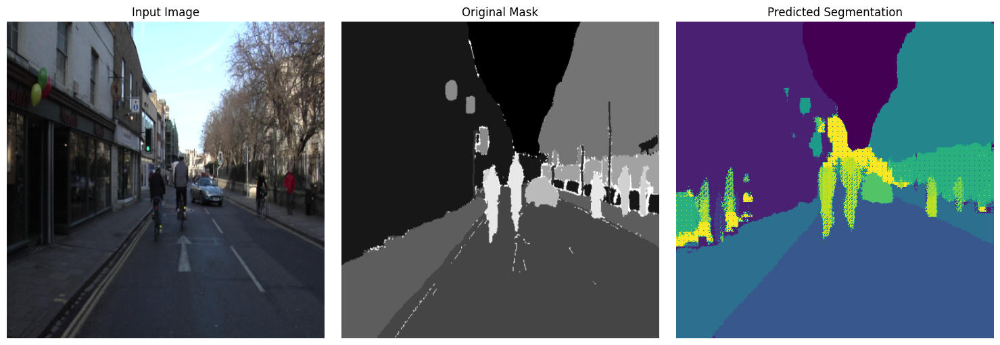

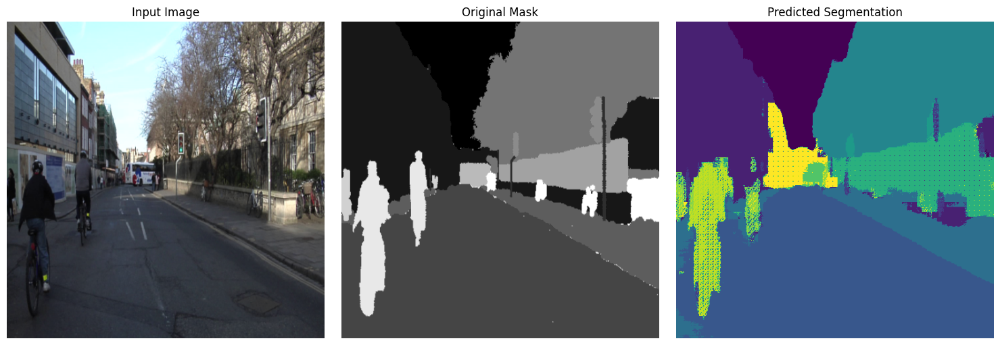

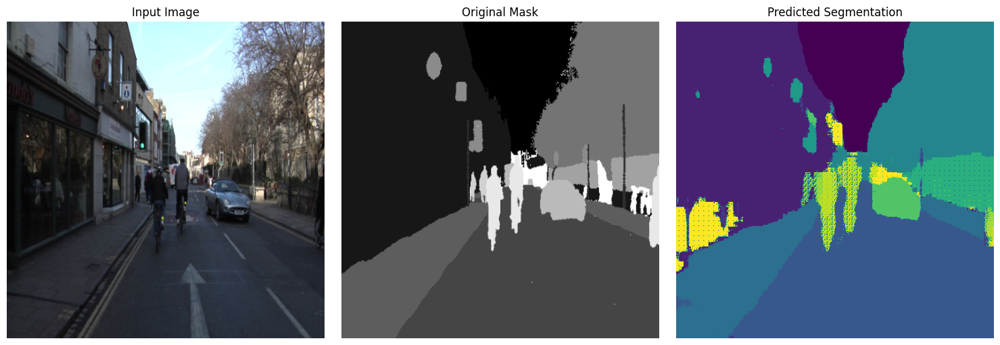

In [ ]:
import os
infer_model = FCN8s_ResNet(num_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "02_base_train", "fcn8s_restnet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "fcn8s_restnet", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

13A.Experiment FCN 8S Resnet (240)

In [ ]:
RUNS_DIR = '/content/drive/MyDrive/Experiment/Runs_Model'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiment/Checkpoint_Model'


output_predictions = []

In [ ]:
# Create model
fcn8s_restnet = FCN8s_ResNet(num_classes=NUM_CLASSES)
fcn8s_restnet.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(fcn8s_restnet.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "02_base_train", "fcn8s_restnet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)



In [ ]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 240
last_best_epoch = 0

experiment_name = "02_base_train_240"
model_name = "fcn8s_restnet_240"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": 0.4,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}

Directory created: /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240


In [ ]:
run_training(model=fcn8s_restnet,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 1/240


Training Loss: 0.7092


Testing Loss: 0.6406
Epoch 2/240


Training Loss: 0.5731


Testing Loss: 0.5343
Epoch 3/240


Training Loss: 0.5407


Testing Loss: 0.5973
Epoch 4/240


Training Loss: 0.5159


Testing Loss: 0.5379
Epoch 5/240


Training Loss: 0.5066


Testing Loss: 0.5138
Epoch 6/240


Training Loss: 0.4773


Testing Loss: 0.4647
Epoch 7/240


Training Loss: 0.4612


Testing Loss: 0.4545
Epoch 8/240


Training Loss: 0.4403


Testing Loss: 0.4336
Epoch 9/240


Training Loss: 0.4186


Testing Loss: 0.5906
Epoch 10/240


Training Loss: 0.4021


Testing Loss: 0.4057
Epoch 11/240


Training Loss: 0.3985


Testing Loss: 0.4335
Epoch 12/240


Training Loss: 0.3912


Testing Loss: 0.4149
Epoch 13/240


Training Loss: 0.3734


Testing Loss: 0.3763
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 14/240


Training Loss: 0.3676


Testing Loss: 0.3822
Epoch 15/240


Training Loss: 0.3607


Testing Loss: 0.4012
Epoch 16/240


Training Loss: 0.3614


Testing Loss: 0.3851
Epoch 17/240


Training Loss: 0.3494


Testing Loss: 0.3504
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 18/240


Training Loss: 0.3379


Testing Loss: 0.3786
Epoch 19/240


Training Loss: 0.3269


Testing Loss: 0.3272
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 20/240


Training Loss: 0.3261


Testing Loss: 0.3228
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 21/240


Training Loss: 0.3203


Testing Loss: 0.3735
Epoch 22/240


Training Loss: 0.3180


Testing Loss: 0.3347
Epoch 23/240


Training Loss: 0.3077


Testing Loss: 0.3419
Epoch 24/240


Training Loss: 0.3072


Testing Loss: 0.3011
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 25/240


Training Loss: 0.2955


Testing Loss: 0.3310
Epoch 26/240


Training Loss: 0.2927


Testing Loss: 0.3054
Epoch 27/240


Training Loss: 0.2885


Testing Loss: 0.3145
Epoch 28/240


Training Loss: 0.2949


Testing Loss: 0.3050
Epoch 29/240


Training Loss: 0.2855


Testing Loss: 0.3012
Epoch 30/240


Training Loss: 0.2843


Testing Loss: 0.3319
Epoch 31/240


Training Loss: 0.2744


Testing Loss: 0.3056
Epoch 32/240


Training Loss: 0.2756


Testing Loss: 0.3064
Epoch 33/240


Training Loss: 0.2753


Testing Loss: 0.3131
Epoch 34/240


Training Loss: 0.2798


Testing Loss: 0.3414
Epoch 35/240


Training Loss: 0.2739


Testing Loss: 0.3037
Epoch 36/240


Training Loss: 0.2762


Testing Loss: 0.3349
Epoch 37/240


Training Loss: 0.2726


Testing Loss: 0.3238
Epoch 38/240


Training Loss: 0.2639


Testing Loss: 0.3014
Epoch 39/240


Training Loss: 0.2617


Testing Loss: 0.3006
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 40/240


Training Loss: 0.2637


Testing Loss: 0.2997
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 41/240


Training Loss: 0.2641


Testing Loss: 0.2940
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 42/240


Training Loss: 0.2599


Testing Loss: 0.3274
Epoch 43/240


Training Loss: 0.2619


Testing Loss: 0.3015
Epoch 44/240


Training Loss: 0.2663


Testing Loss: 0.2993
Epoch 45/240


Training Loss: 0.2593


Testing Loss: 0.3021
Epoch 46/240


Training Loss: 0.2586


Testing Loss: 0.2784
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 47/240


Training Loss: 0.2533


Testing Loss: 0.2901
Epoch 48/240


Training Loss: 0.2542


Testing Loss: 0.2881
Epoch 49/240


Training Loss: 0.2505


Testing Loss: 0.3024
Epoch 50/240


Training Loss: 0.2514


Testing Loss: 0.2740
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 51/240


Training Loss: 0.2549


Testing Loss: 0.2813
Epoch 52/240


Training Loss: 0.2511


Testing Loss: 0.2739
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 53/240


Training Loss: 0.2480


Testing Loss: 0.2765
Epoch 54/240


Training Loss: 0.2454


Testing Loss: 0.2832
Epoch 55/240


Training Loss: 0.2436


Testing Loss: 0.2928
Epoch 56/240


Training Loss: 0.2428


Testing Loss: 0.2847
Epoch 57/240


Training Loss: 0.2486


Testing Loss: 0.2872
Epoch 58/240


Training Loss: 0.2456


Testing Loss: 0.3069
Epoch 59/240


Training Loss: 0.2410


Testing Loss: 0.2869
Epoch 60/240


Training Loss: 0.2436


Testing Loss: 0.3060
Epoch 61/240


Training Loss: 0.2387


Testing Loss: 0.2996
Epoch 62/240


Training Loss: 0.2418


Testing Loss: 0.2824
Epoch 63/240


Training Loss: 0.2443


Testing Loss: 0.3176
Epoch 64/240


Training Loss: 0.2450


Testing Loss: 0.2919
Epoch 65/240


Training Loss: 0.2428


Testing Loss: 0.2821
Epoch 66/240


Training Loss: 0.2406


Testing Loss: 0.2778
Epoch 67/240


Training Loss: 0.2381


Testing Loss: 0.2784
Epoch 68/240


Training Loss: 0.2385


Testing Loss: 0.2876
Epoch 69/240


Training Loss: 0.2378


Testing Loss: 0.2790
Epoch 70/240


Training Loss: 0.2365


Testing Loss: 0.2686
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 71/240


Training Loss: 0.2324


Testing Loss: 0.2788
Epoch 72/240


Training Loss: 0.2363


Testing Loss: 0.2761
Epoch 73/240


Training Loss: 0.2313


Testing Loss: 0.2968
Epoch 74/240


Training Loss: 0.2345


Testing Loss: 0.2684
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 75/240


Training Loss: 0.2347


Testing Loss: 0.2827
Epoch 76/240


Training Loss: 0.2366


Testing Loss: 0.2749
Epoch 77/240


Training Loss: 0.2317


Testing Loss: 0.2745
Epoch 78/240


Training Loss: 0.2310


Testing Loss: 0.2788
Epoch 79/240


Training Loss: 0.2342


Testing Loss: 0.2684
Epoch 80/240


Training Loss: 0.2340


Testing Loss: 0.2745
Epoch 81/240


Training Loss: 0.2313


Testing Loss: 0.2817
Epoch 82/240


Training Loss: 0.2293


Testing Loss: 0.2760
Epoch 83/240


Training Loss: 0.2303


Testing Loss: 0.3066
Epoch 84/240


Training Loss: 0.2294


Testing Loss: 0.2685
Epoch 85/240


Training Loss: 0.2287


Testing Loss: 0.2942
Epoch 86/240


Training Loss: 0.2280


Testing Loss: 0.2842
Epoch 87/240


Training Loss: 0.2270


Testing Loss: 0.3165
Epoch 88/240


Training Loss: 0.2280


Testing Loss: 0.2782
Epoch 89/240


Training Loss: 0.2257


Testing Loss: 0.2766
Epoch 90/240


Training Loss: 0.2260


Testing Loss: 0.2744
Epoch 91/240


Training Loss: 0.2239


Testing Loss: 0.2747
Epoch 92/240


Training Loss: 0.2268


Testing Loss: 0.2671
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 93/240


Training Loss: 0.2237


Testing Loss: 0.2662
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 94/240


Training Loss: 0.2275


Testing Loss: 0.2754
Epoch 95/240


Training Loss: 0.2277


Testing Loss: 0.2861
Epoch 96/240


Training Loss: 0.2246


Testing Loss: 0.2658
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 97/240


Training Loss: 0.2237


Testing Loss: 0.2647
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 98/240


Training Loss: 0.2235


Testing Loss: 0.2774
Epoch 99/240


Training Loss: 0.2265


Testing Loss: 0.2860
Epoch 100/240


Training Loss: 0.2213


Testing Loss: 0.2668
Epoch 101/240


Training Loss: 0.2218


Testing Loss: 0.2783
Epoch 102/240


Training Loss: 0.2220


Testing Loss: 0.2895
Epoch 103/240


Training Loss: 0.2257


Testing Loss: 0.2853
Epoch 104/240


Training Loss: 0.2245


Testing Loss: 0.2719
Epoch 105/240


Training Loss: 0.2224


Testing Loss: 0.2855
Epoch 106/240


Training Loss: 0.2194


Testing Loss: 0.2991
Epoch 107/240


Training Loss: 0.2217


Testing Loss: 0.2692
Epoch 108/240


Training Loss: 0.2206


Testing Loss: 0.2755
Epoch 109/240


Training Loss: 0.2212


Testing Loss: 0.2644
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 110/240


Training Loss: 0.2203


Testing Loss: 0.3000
Epoch 111/240


Training Loss: 0.2301


Testing Loss: 0.2966
Epoch 112/240


Training Loss: 0.2320


Testing Loss: 0.2877
Epoch 113/240


Training Loss: 0.2269


Testing Loss: 0.3134
Epoch 114/240


Training Loss: 0.2247


Testing Loss: 0.2908
Epoch 115/240


Training Loss: 0.2281


Testing Loss: 0.3465
Epoch 116/240


Training Loss: 0.2221


Testing Loss: 0.2828
Epoch 117/240


Training Loss: 0.2263


Testing Loss: 0.2907
Epoch 118/240


Training Loss: 0.2224


Testing Loss: 0.2850
Epoch 119/240


Training Loss: 0.2244


Testing Loss: 0.3057
Epoch 120/240


Training Loss: 0.2256


Testing Loss: 0.2702
Epoch 121/240


Training Loss: 0.2169


Testing Loss: 0.2678
Epoch 122/240


Training Loss: 0.2186


Testing Loss: 0.2793
Epoch 123/240


Training Loss: 0.2181


Testing Loss: 0.2696
Epoch 124/240


Training Loss: 0.2191


Testing Loss: 0.2719
Epoch 125/240


Training Loss: 0.2194


Testing Loss: 0.2750
Epoch 126/240


Training Loss: 0.2183


Testing Loss: 0.2767
Epoch 127/240


Training Loss: 0.2166


Testing Loss: 0.2602
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 128/240


Training Loss: 0.2164


Testing Loss: 0.2849
Epoch 129/240


Training Loss: 0.2171


Testing Loss: 0.2923
Epoch 130/240


Training Loss: 0.2142


Testing Loss: 0.2864
Epoch 131/240


Training Loss: 0.2134


Testing Loss: 0.2698
Epoch 132/240


Training Loss: 0.2135


Testing Loss: 0.2873
Epoch 133/240


Training Loss: 0.2138


Testing Loss: 0.2708
Epoch 134/240


Training Loss: 0.2153


Testing Loss: 0.2627
Epoch 135/240


Training Loss: 0.2128


Testing Loss: 0.2867
Epoch 136/240


Training Loss: 0.2118


Testing Loss: 0.2805
Epoch 137/240


Training Loss: 0.2160


Testing Loss: 0.2911
Epoch 138/240


Training Loss: 0.2125


Testing Loss: 0.2709
Epoch 139/240


Training Loss: 0.2140


Testing Loss: 0.2849
Epoch 140/240


Training Loss: 0.2127


Testing Loss: 0.2658
Epoch 141/240


Training Loss: 0.2121


Testing Loss: 0.2873
Epoch 142/240


Training Loss: 0.2120


Testing Loss: 0.2684
Epoch 143/240


Training Loss: 0.2150


Testing Loss: 0.2887
Epoch 144/240


Training Loss: 0.2140


Testing Loss: 0.2988
Epoch 145/240


Training Loss: 0.2118


Testing Loss: 0.2757
Epoch 146/240


Training Loss: 0.2132


Testing Loss: 0.2892
Epoch 147/240


Training Loss: 0.2129


Testing Loss: 0.2698
Epoch 148/240


Training Loss: 0.2110


Testing Loss: 0.2762
Epoch 149/240


Training Loss: 0.2129


Testing Loss: 0.2895
Epoch 150/240


Training Loss: 0.2112


Testing Loss: 0.2899
Epoch 151/240


Training Loss: 0.2112


Testing Loss: 0.2715
Epoch 152/240


Training Loss: 0.2113


Testing Loss: 0.2735
Epoch 153/240


Training Loss: 0.2119


Testing Loss: 0.2740
Epoch 154/240


Training Loss: 0.2154


Testing Loss: 0.2943
Epoch 155/240


Training Loss: 0.2099


Testing Loss: 0.2864
Epoch 156/240


Training Loss: 0.2136


Testing Loss: 0.2794
Epoch 157/240


Training Loss: 0.2130


Testing Loss: 0.3001
Epoch 158/240


Training Loss: 0.2129


Testing Loss: 0.2717
Epoch 159/240


Training Loss: 0.2119


Testing Loss: 0.2861
Epoch 160/240


Training Loss: 0.2120


Testing Loss: 0.2844
Epoch 161/240


Training Loss: 0.2133


Testing Loss: 0.2810
Epoch 162/240


Training Loss: 0.2102


Testing Loss: 0.3007
Epoch 163/240


Training Loss: 0.2088


Testing Loss: 0.2826
Epoch 164/240


Training Loss: 0.2103


Testing Loss: 0.2774
Epoch 165/240


Training Loss: 0.2093


Testing Loss: 0.2746
Epoch 166/240


Training Loss: 0.2100


Testing Loss: 0.2816
Epoch 167/240


Training Loss: 0.2082


Testing Loss: 0.2745
Epoch 168/240


Training Loss: 0.2107


Testing Loss: 0.2918
Epoch 169/240


Training Loss: 0.2093


Testing Loss: 0.2725
Epoch 170/240


Training Loss: 0.2066


Testing Loss: 0.2766
Epoch 171/240


Training Loss: 0.2102


Testing Loss: 0.2826
Epoch 172/240


Training Loss: 0.2125


Testing Loss: 0.2937
Epoch 173/240


Training Loss: 0.2092


Testing Loss: 0.2846
Epoch 174/240


Training Loss: 0.2100


Testing Loss: 0.3033
Epoch 175/240


Training Loss: 0.2114


Testing Loss: 0.2938
Epoch 176/240


Training Loss: 0.2115


Testing Loss: 0.2953
Epoch 177/240


Training Loss: 0.2093


Testing Loss: 0.2839
Epoch 178/240


Training Loss: 0.2128


Testing Loss: 0.3082
Epoch 179/240


Training Loss: 0.2108


Testing Loss: 0.2872
Epoch 180/240


Training Loss: 0.2085


Testing Loss: 0.2944
Epoch 181/240


Training Loss: 0.2052


Testing Loss: 0.2995
Epoch 182/240


Training Loss: 0.2074


Testing Loss: 0.2863
Epoch 183/240


Training Loss: 0.2088


Testing Loss: 0.2686
Epoch 184/240


Training Loss: 0.2106


Testing Loss: 0.2677
Epoch 185/240


Training Loss: 0.2115


Testing Loss: 0.3040
Epoch 186/240


Training Loss: 0.2103


Testing Loss: 0.2866
Epoch 187/240


Training Loss: 0.2081


Testing Loss: 0.2889
Epoch 188/240


Training Loss: 0.2040


Testing Loss: 0.2955
Epoch 189/240


Training Loss: 0.2075


Testing Loss: 0.2792
Epoch 190/240


Training Loss: 0.2086


Testing Loss: 0.2858
Epoch 191/240


Training Loss: 0.2080


Testing Loss: 0.2802
Epoch 192/240


Training Loss: 0.2049


Testing Loss: 0.2698
Epoch 193/240


Training Loss: 0.2086


Testing Loss: 0.2640
Epoch 194/240


Training Loss: 0.2070


Testing Loss: 0.2730
Epoch 195/240


Training Loss: 0.2084


Testing Loss: 0.2646
Epoch 196/240


Training Loss: 0.2088


Testing Loss: 0.2898
Epoch 197/240


Training Loss: 0.2049


Testing Loss: 0.3874
Epoch 198/240


Training Loss: 0.2066


Testing Loss: 0.2722
Epoch 199/240


Training Loss: 0.2064


Testing Loss: 0.2859
Epoch 200/240


Training Loss: 0.2062


Testing Loss: 0.2869
Epoch 201/240


Training Loss: 0.2157


Testing Loss: 0.3094
Epoch 202/240


Training Loss: 0.2153


Testing Loss: 0.2687
Epoch 203/240


Training Loss: 0.2167


Testing Loss: 0.2902
Epoch 204/240


Training Loss: 0.2129


Testing Loss: 0.2691
Epoch 205/240


Training Loss: 0.2122


Testing Loss: 0.2674
Epoch 206/240


Training Loss: 0.2100


Testing Loss: 0.2634
Epoch 207/240


Training Loss: 0.2039


Testing Loss: 0.2742
Epoch 208/240


Training Loss: 0.2054


Testing Loss: 0.2789
Epoch 209/240


Training Loss: 0.2077


Testing Loss: 0.2875
Epoch 210/240


Training Loss: 0.2049


Testing Loss: 0.2792
Epoch 211/240


Training Loss: 0.2066


Testing Loss: 0.2797
Epoch 212/240


Training Loss: 0.2069


Testing Loss: 0.2837
Epoch 213/240


Training Loss: 0.2036


Testing Loss: 0.2682
Epoch 214/240


Training Loss: 0.2019


Testing Loss: 0.2777
Epoch 215/240


Training Loss: 0.2054


Testing Loss: 0.2721
Epoch 216/240


Training Loss: 0.2019


Testing Loss: 0.2713
Epoch 217/240


Training Loss: 0.2051


Testing Loss: 0.2723
Epoch 218/240


Training Loss: 0.2030


Testing Loss: 0.2700
Epoch 219/240


Training Loss: 0.2031


Testing Loss: 0.2597
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/02_base_train_240/fcn8s_restnet_240

Epoch 220/240


Training Loss: 0.2018


Testing Loss: 0.2685
Epoch 221/240


Training Loss: 0.2064


Testing Loss: 0.2933
Epoch 222/240


Training Loss: 0.2061


Testing Loss: 0.2682
Epoch 223/240


Training Loss: 0.2022


Testing Loss: 0.2714
Epoch 224/240


Training Loss: 0.2015


Testing Loss: 0.2801
Epoch 225/240


Training Loss: 0.2036


Testing Loss: 0.2812
Epoch 226/240


Training Loss: 0.2037


Testing Loss: 0.2648
Epoch 227/240


Training Loss: 0.2027


Testing Loss: 0.2860
Epoch 228/240


Training Loss: 0.2026


Testing Loss: 0.2877
Epoch 229/240


Training Loss: 0.2036


Testing Loss: 0.2691
Epoch 230/240


Training Loss: 0.2062


Testing Loss: 0.2789
Epoch 231/240


Training Loss: 0.2033


Testing Loss: 0.2828
Epoch 232/240


Training Loss: 0.2020


Testing Loss: 0.2659
Epoch 233/240


Training Loss: 0.2027


Testing Loss: 0.2632
Epoch 234/240


Training Loss: 0.2031


Testing Loss: 0.3095
Epoch 235/240


Training Loss: 0.2055


Testing Loss: 0.2851
Epoch 236/240


Training Loss: 0.2049


Testing Loss: 0.2805
Epoch 237/240


Training Loss: 0.2016


Testing Loss: 0.2847
Epoch 238/240


Training Loss: 0.2065


Testing Loss: 0.2723
Epoch 239/240


Training Loss: 0.2027


Testing Loss: 0.2867
Epoch 240/240


Training Loss: 0.2005


Testing Loss: 0.2825
[INFO] Finishing training with 240 epochs for 44.49 minutes
Training completed with best Dice Loss of 0.2597 at epoch 219


Loaded checkpoint from epoch 219 with best Dice Loss: 0.2597


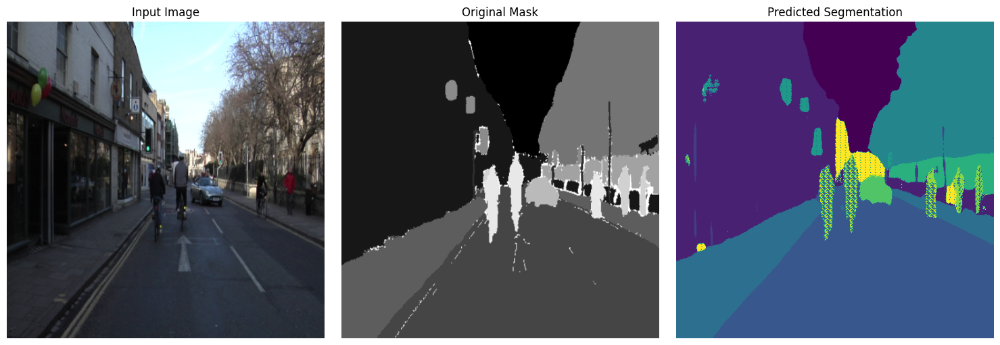

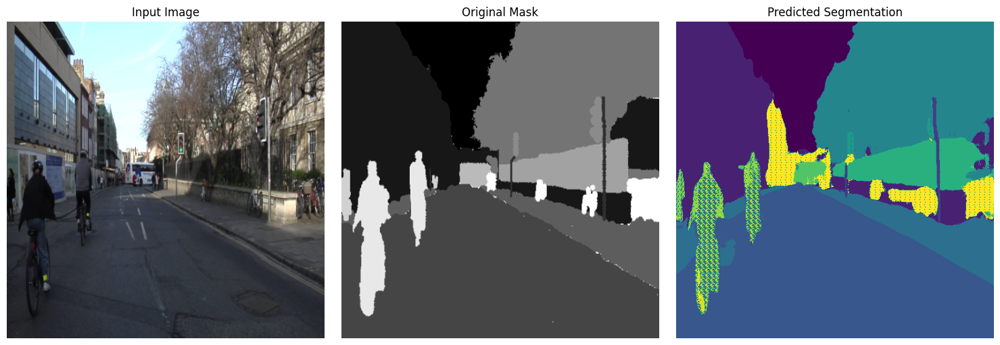

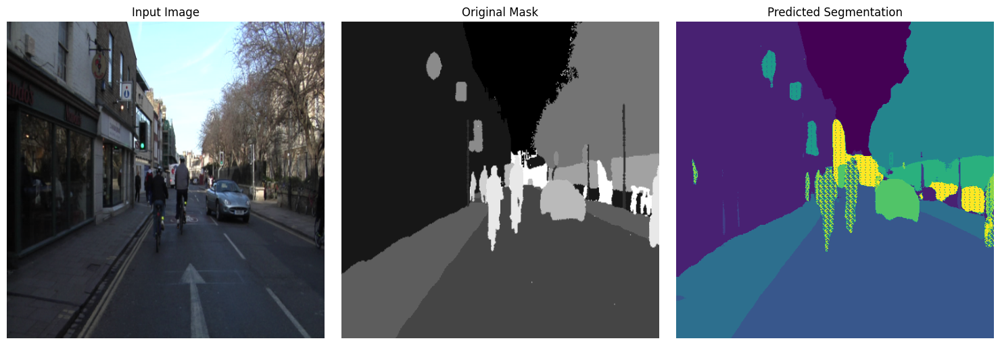

In [ ]:
import os
infer_model = FCN8s_ResNet(num_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "02_base_train_240", "fcn8s_restnet_240")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "fcn8s_restnet", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

13C.Experiment FCN 8S Resnet (120)

In [ ]:
RUNS_DIR = '/content/drive/MyDrive/Experiments/Run_Model'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiments/Cp_Model'


output_predictions = []

In [ ]:
# Create model
fcn8s_restnet = FCN8s_ResNet(num_classes=NUM_CLASSES)
fcn8s_restnet.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(fcn8s_restnet.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "02_base_train", "fcn8s_restnet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


Loaded checkpoint from epoch 10 with best Dice Loss: 0.3398


In [ ]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 120
last_best_epoch = loaded_epoch

experiment_name = "02_base_train_120"
model_name = "fcn8s_restnet_120"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": loaded_dice,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}

Directory created: /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train_120/fcn8s_restnet_120


In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [ ]:
run_training(model=fcn8s_restnet,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 11/120


Training:  50%|█████     | 23/46 [00:03<00:01, 12.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:03<00:00, 17.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:04<00:00, 19.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:04<00:00, 18.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:04<00:00, 20.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.


Training Loss: 0.4253


Testing Loss: 0.9007
Epoch 12/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 15.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 18.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 20.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: 0.0195


Testing Loss: 0.8964
Epoch 13/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 14/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/queues.py", line 239, in _feed
    reader_close()
  File "/usr/lib/python3.10/multiprocessing/connection.py", line 177, in close
    self._close()
  File "/usr/lib/python3.10/multiprocessing/connection.py", line 361, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor
Training:  20%|█▉        | 9/46 [00:02<00:06,  5.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:02<00:03, 10.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 15.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 18.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:03<00:00, 20.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 15/120


Training:   2%|▏         | 1/46 [00:00<00:44,  1.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8964
Epoch 16/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 11.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 12.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 16.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 18.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 19.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:03<00:00, 20.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8963
Epoch 17/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8963
Epoch 18/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8963
Epoch 19/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 20/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 18.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8965
Epoch 21/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 15.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8963
Epoch 22/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 23/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 14.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 24/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 25/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8963
Epoch 26/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8964
Epoch 27/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 19.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 19.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: 0.0194


Testing Loss: 0.8923
Epoch 28/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 29/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 30/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 31/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:   9%|▊         | 4/46 [00:01<00:09,  4.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 32/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 33/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 34/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 35/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  7.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 36/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:06,  6.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 37/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:02, 14.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 38/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 39/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 40/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 20.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 41/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 20.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 42/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 43/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 44/120


Training:   4%|▍         | 2/46 [00:01<00:22,  2.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 45/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 46/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 17.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 20.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 20.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 47/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 48/120


Training:   7%|▋         | 3/46 [00:01<00:15,  2.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 20.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8920
Epoch 49/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:03<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 50/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 51/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:02, 14.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 17.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 18.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 20.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 20.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 20.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 52/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 20.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 53/120


Training:   2%|▏         | 1/46 [00:01<00:45,  1.02s/it]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:08,  5.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 54/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 13.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 55/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 56/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 16.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 20.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 57/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 58/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 15.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 19.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 59/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 20.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 60/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 61/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 62/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 63/120


Training:   4%|▍         | 2/46 [00:01<00:22,  2.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 64/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 65/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 66/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 67/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 68/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 69/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  8.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 70/120


Training:   4%|▍         | 2/46 [00:01<00:23,  1.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 20.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 71/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 72/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 73/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 21.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 74/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  9.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 16.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 16.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:01, 18.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 75/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 17.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8923
Epoch 76/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 77/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 78/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 79/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 80/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 81/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 82/120


Training:   4%|▍         | 2/46 [00:01<00:23,  1.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 83/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:02, 14.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 16.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 84/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  7.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 85/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 86/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 87/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 88/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 89/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:06,  6.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 90/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 91/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 92/120


Training:   4%|▍         | 2/46 [00:01<00:23,  1.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:03<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 93/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 94/120


Training:   2%|▏         | 1/46 [00:01<00:46,  1.04s/it]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:08,  4.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 95/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 17.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 96/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 20.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 97/120


Training:   4%|▍         | 2/46 [00:01<00:23,  1.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8920
Epoch 98/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 99/120


Training:   7%|▋         | 3/46 [00:01<00:15,  2.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 16.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 18.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 100/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 101/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 102/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 103/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 104/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 105/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 16.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 106/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 107/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  9.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 108/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 109/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 20.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 110/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:06,  5.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 15.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 17.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 20.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 21.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 111/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 112/120


Training:   4%|▍         | 2/46 [00:01<00:22,  1.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03, 10.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:02<00:01, 15.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 17.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 20.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:03<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 113/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  7.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 114/120


Training:   7%|▋         | 3/46 [00:01<00:14,  3.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:02, 14.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 18.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 19.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 115/120


Training:   4%|▍         | 2/46 [00:01<00:21,  2.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8921
Epoch 116/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
Epoch 117/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 13.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 15.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 16.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 19.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 118/120


Training:   4%|▍         | 2/46 [00:01<00:20,  2.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:06,  5.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:02, 12.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:01, 15.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.8922
Epoch 119/120


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 21.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8922
Epoch 120/120


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.8921
[INFO] Finishing training with 110 epochs for 9.28 minutes
Training completed with best Dice Loss of 0.3398 at epoch 10


Loaded checkpoint from epoch 10 with best Dice Loss: 0.3398


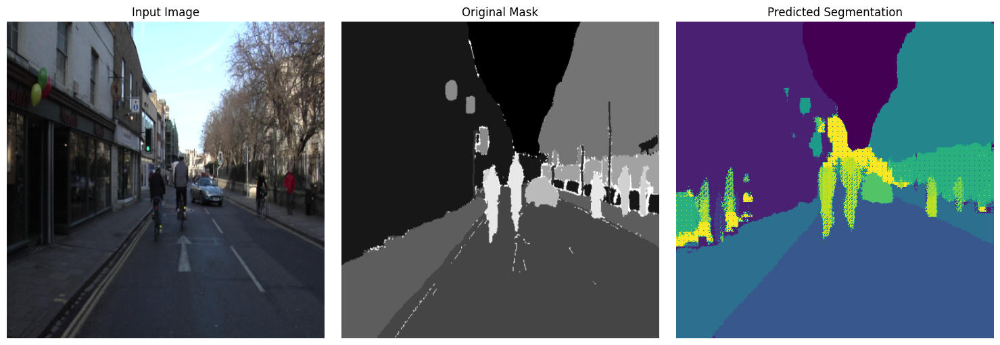

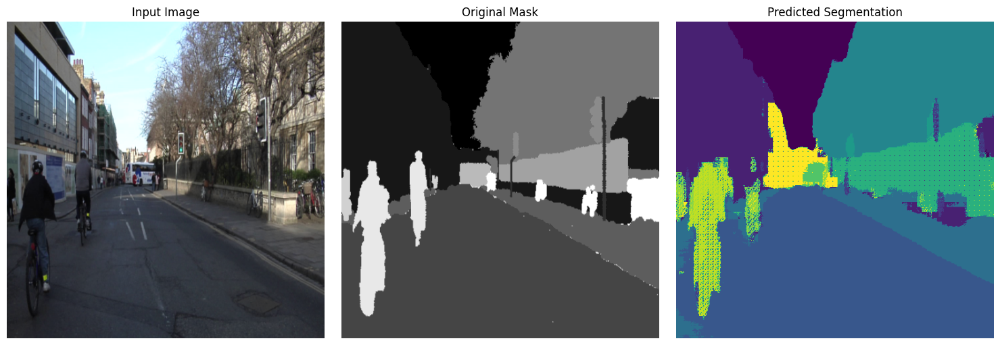

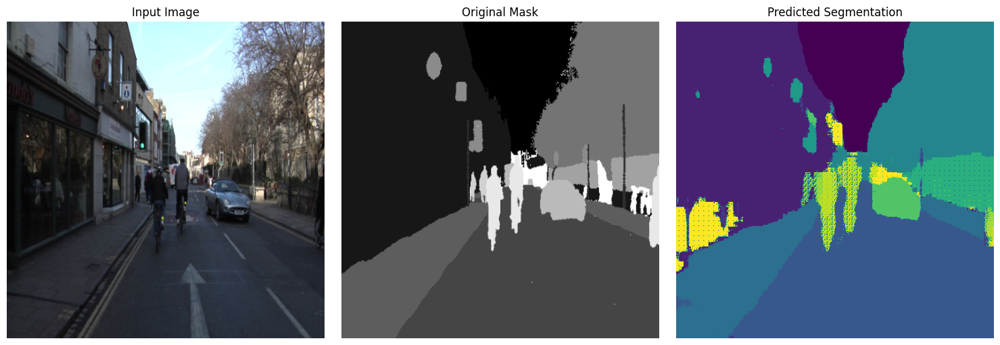

In [ ]:
import os
infer_model = FCN8s_ResNet(num_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "02_base_train", "fcn8s_restnet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "fcn8s_restnet", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

14A.Experiment FCN 8S VGG (160)

In [ ]:
RUNS_DIR = '/content/drive/MyDrive/Experiment/Runs_Model'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiment/Checkpoint_Model'


output_predictions = []

In [ ]:
# Create model
fcn8s_vgg = FCN8s_VGG(num_classes=NUM_CLASSES)
fcn8s_vgg.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(fcn8s_vgg.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()


In [ ]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 160
last_best_epoch = 0

experiment_name = "01_base_train_160"
model_name = "fcn8s_vgg_160"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": 0.4,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}



Directory created: /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160


In [ ]:
# Setup summary writer
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [ ]:
run_training(model=fcn8s_vgg,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 1/160


Training Loss: 0.7855


Testing Loss: 0.7058
Epoch 2/160


Training Loss: 0.6796


Testing Loss: 0.6489
Epoch 3/160


Training Loss: 0.6354


Testing Loss: 0.5889
Epoch 4/160


Training Loss: 0.6074


Testing Loss: 0.5451
Epoch 5/160


Training Loss: 0.5743


Testing Loss: 0.5272
Epoch 6/160


Training Loss: 0.5644


Testing Loss: 0.5069
Epoch 7/160


Training Loss: 0.5526


Testing Loss: 0.5107
Epoch 8/160


Training Loss: 0.5415


Testing Loss: 0.5196
Epoch 9/160


Training Loss: 0.5329


Testing Loss: 0.4966
Epoch 10/160


Training Loss: 0.5242


Testing Loss: 0.4710
Epoch 11/160


Training Loss: 0.5286


Testing Loss: 0.5406
Epoch 12/160


Training Loss: 0.5297


Testing Loss: 0.4504
Epoch 13/160


Training Loss: 0.5140


Testing Loss: 0.4721
Epoch 14/160


Training Loss: 0.5014


Testing Loss: 0.4695
Epoch 15/160


Training Loss: 0.5012


Testing Loss: 0.4395
Epoch 16/160


Training Loss: 0.4890


Testing Loss: 0.4504
Epoch 17/160


Training Loss: 0.4852


Testing Loss: 0.4521
Epoch 18/160


Training Loss: 0.4820


Testing Loss: 0.4370
Epoch 19/160


Training Loss: 0.4701


Testing Loss: 0.4824
Epoch 20/160


Training Loss: 0.4631


Testing Loss: 0.4082
Epoch 21/160


Training Loss: 0.4492


Testing Loss: 0.4358
Epoch 22/160


Training Loss: 0.4436


Testing Loss: 0.4233
Epoch 23/160


Training Loss: 0.4460


Testing Loss: 0.4110
Epoch 24/160


Training Loss: 0.4416


Testing Loss: 0.4366
Epoch 25/160


Training Loss: 0.4329


Testing Loss: 0.4097
Epoch 26/160


Training Loss: 0.4308


Testing Loss: 0.4221
Epoch 27/160


Training Loss: 0.4517


Testing Loss: 0.4097
Epoch 28/160


Training:  11%|█         | 5/46 [00:01<00:07,  5.13it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.4235


Testing Loss: 0.4084
Epoch 29/160


Training Loss: 0.4205


Testing Loss: 0.4070
Epoch 30/160


Training Loss: 0.4051


Testing Loss: 0.4003
Epoch 31/160


Training Loss: 0.4052


Testing Loss: 0.4061
Epoch 32/160


Training Loss: 0.4004


Testing Loss: 0.3943
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 33/160


Training Loss: 0.3970


Testing Loss: 0.4029
Epoch 34/160


Training Loss: 0.3918


Testing Loss: 0.3911
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 35/160


Training Loss: 0.3880


Testing Loss: 0.3889
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 36/160


Training Loss: 0.3851


Testing Loss: 0.3963
Epoch 37/160


Training Loss: 0.3840


Testing Loss: 0.3646
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 38/160


Training Loss: 0.3825


Testing Loss: 0.4009
Epoch 39/160


Training Loss: 0.3796


Testing Loss: 0.3770
Epoch 40/160


Training Loss: 0.3820


Testing Loss: 0.3920
Epoch 41/160


Training Loss: 0.3821


Testing Loss: 0.3901
Epoch 42/160


Training Loss: 0.3851


Testing Loss: 0.4148
Epoch 43/160


Training Loss: 0.3761


Testing Loss: 0.3853
Epoch 44/160


Training Loss: 0.3694


Testing Loss: 0.3822
Epoch 45/160


Training Loss: 0.3811


Testing Loss: 0.3701
Epoch 46/160


Training Loss: 0.3645


Testing Loss: 0.3824
Epoch 47/160


Training:   9%|▊         | 4/46 [00:01<00:10,  4.14it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.3535


Testing Loss: 0.3630
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 48/160


Training Loss: 0.3707


Testing Loss: 0.3699
Epoch 49/160


Training Loss: 0.3645


Testing Loss: 0.3576
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 50/160


Training Loss: 0.3605


Testing Loss: 0.3564
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 51/160


Training Loss: 0.3501


Testing Loss: 0.3633
Epoch 52/160


Training Loss: 0.3451


Testing Loss: 0.3545
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 53/160


Training Loss: 0.3477


Testing Loss: 0.3809
Epoch 54/160


Training Loss: 0.3461


Testing Loss: 0.3788
Epoch 55/160


Training Loss: 0.3426


Testing Loss: 0.3512
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 56/160


Training Loss: 0.3352


Testing Loss: 0.3553
Epoch 57/160


Training Loss: 0.3257


Testing Loss: 0.3544
Epoch 58/160


Training Loss: 0.3280


Testing Loss: 0.3418
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 59/160


Training Loss: 0.3191


Testing Loss: 0.3497
Epoch 60/160


Training Loss: 0.3201


Testing Loss: 0.3579
Epoch 61/160


Training Loss: 0.3103


Testing Loss: 0.3715
Epoch 62/160


Training Loss: 0.3146


Testing Loss: 0.3486
Epoch 63/160


Training Loss: 0.3124


Testing Loss: 0.3442
Epoch 64/160


Training Loss: 0.3164


Testing Loss: 0.3295
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 65/160


Training Loss: 0.3066


Testing Loss: 0.3456
Epoch 66/160


Training Loss: 0.3089


Testing Loss: 0.3301
Epoch 67/160


Training Loss: 0.3122


Testing Loss: 0.3303
Epoch 68/160


Training Loss: 0.3064


Testing Loss: 0.3316
Epoch 69/160


Training Loss: 0.3045


Testing Loss: 0.3360
Epoch 70/160


Training:  87%|████████▋ | 40/46 [00:04<00:00, 12.16it/s]


[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:05<00:00, 12.62it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.3035


Testing Loss: 0.3640
Epoch 71/160


Training Loss: 0.3019


Testing Loss: 0.3677
Epoch 72/160


Training Loss: 0.3016


Testing Loss: 0.3433
Epoch 73/160


Training Loss: 0.2943


Testing Loss: 0.3533
Epoch 74/160


Training Loss: 0.2907


Testing Loss: 0.3389
Epoch 75/160


Training Loss: 0.2900


Testing Loss: 0.3291
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 76/160


Training Loss: 0.2920


Testing Loss: 0.3121
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 77/160


Training Loss: 0.2917


Testing Loss: 0.3075
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 78/160


Training Loss: 0.2930


Testing Loss: 0.3374
Epoch 79/160


Training Loss: 0.2845


Testing Loss: 0.3350
Epoch 80/160


Training Loss: 0.2874


Testing Loss: 0.3263
Epoch 81/160


Training Loss: 0.2881


Testing Loss: 0.3320
Epoch 82/160


Training Loss: 0.2848


Testing Loss: 0.3102
Epoch 83/160


Training Loss: 0.2749


Testing Loss: 0.3058
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 84/160


Training Loss: 0.2802


Testing Loss: 0.3258
Epoch 85/160


Training Loss: 0.2781


Testing Loss: 0.3031
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 86/160


Training Loss: 0.2778


Testing Loss: 0.3016
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 87/160


Training Loss: 0.2807


Testing Loss: 0.3260
Epoch 88/160


Training Loss: 0.2802


Testing Loss: 0.3253
Epoch 89/160


Training Loss: 0.2860


Testing Loss: 0.3140
Epoch 90/160


Training Loss: 0.2792


Testing Loss: 0.3189
Epoch 91/160


Training Loss: 0.2733


Testing Loss: 0.3341
Epoch 92/160


Training Loss: 0.2721


Testing Loss: 0.3197
Epoch 93/160


Training Loss: 0.2716


Testing Loss: 0.3157
Epoch 94/160


Training Loss: 0.2687


Testing Loss: 0.3132
Epoch 95/160


Training Loss: 0.2726


Testing Loss: 0.3365
Epoch 96/160


Training Loss: 0.2719


Testing Loss: 0.3091
Epoch 97/160


Training Loss: 0.2818


Testing Loss: 0.3074
Epoch 98/160


Training Loss: 0.2747


Testing Loss: 0.3375
Epoch 99/160


Training Loss: 0.2747


Testing Loss: 0.3279
Epoch 100/160


Training Loss: 0.2709


Testing Loss: 0.3021
Epoch 101/160


Training Loss: 0.2716


Testing Loss: 0.3191
Epoch 102/160


Training Loss: 0.2707


Testing Loss: 0.2900
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 103/160


Training Loss: 0.2694


Testing Loss: 0.3116
Epoch 104/160


Training Loss: 0.2705


Testing Loss: 0.3308
Epoch 105/160


Training Loss: 0.2759


Testing Loss: 0.3323
Epoch 106/160


Training Loss: 0.2720


Testing Loss: 0.3167
Epoch 107/160


Training Loss: 0.2669


Testing Loss: 0.3091
Epoch 108/160


Training Loss: 0.2641


Testing Loss: 0.3197
Epoch 109/160


Training Loss: 0.2644


Testing Loss: 0.3117
Epoch 110/160


Training Loss: 0.2626


Testing Loss: 0.3089
Epoch 111/160


Training Loss: 0.2623


Testing Loss: 0.3147
Epoch 112/160


Training Loss: 0.2627


Testing Loss: 0.3186
Epoch 113/160


Training Loss: 0.2609


Testing Loss: 0.3128
Epoch 114/160


Training Loss: 0.2583


Testing Loss: 0.3144
Epoch 115/160


Training Loss: 0.2589


Testing Loss: 0.3320
Epoch 116/160


Training Loss: 0.2575


Testing Loss: 0.3140
Epoch 117/160


Training Loss: 0.2584


Testing Loss: 0.3162
Epoch 118/160


Training Loss: 0.2598


Testing Loss: 0.2988
Epoch 119/160


Training Loss: 0.2571


Testing Loss: 0.3137
Epoch 120/160


Training Loss: 0.2580


Testing Loss: 0.3050
Epoch 121/160


Training Loss: 0.2592


Testing Loss: 0.3260
Epoch 122/160


Training Loss: 0.2574


Testing Loss: 0.3157
Epoch 123/160


Training Loss: 0.2610


Testing Loss: 0.3272
Epoch 124/160


Training Loss: 0.2574


Testing Loss: 0.3126
Epoch 125/160


Training Loss: 0.2524


Testing Loss: 0.3064
Epoch 126/160


Training Loss: 0.2541


Testing Loss: 0.2902
Epoch 127/160


Training Loss: 0.2536


Testing Loss: 0.3129
Epoch 128/160


Training Loss: 0.2611


Testing Loss: 0.3228
Epoch 129/160


Training Loss: 0.2750


Testing Loss: 0.3238
Epoch 130/160


Training Loss: 0.2803


Testing Loss: 0.3353
Epoch 131/160


Training Loss: 0.2645


Testing Loss: 0.3034
Epoch 132/160


Training Loss: 0.2608


Testing Loss: 0.2973
Epoch 133/160


Training Loss: 0.2618


Testing Loss: 0.3141
Epoch 134/160


Training Loss: 0.2595


Testing Loss: 0.3082
Epoch 135/160


Training Loss: 0.2568


Testing Loss: 0.3000
Epoch 136/160


Training Loss: 0.2521


Testing Loss: 0.2964
Epoch 137/160


Training Loss: 0.2498


Testing Loss: 0.2892
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_160/fcn8s_vgg_160

Epoch 138/160


Training Loss: 0.2498


Testing Loss: 0.3129
Epoch 139/160


Training Loss: 0.2522


Testing Loss: 0.3094
Epoch 140/160


Training Loss: 0.2500


Testing Loss: 0.3006
Epoch 141/160


Training Loss: 0.2562


Testing Loss: 0.3199
Epoch 142/160


Training Loss: 0.2578


Testing Loss: 0.3268
Epoch 143/160


Training Loss: 0.2521


Testing Loss: 0.3030
Epoch 144/160


Training:  63%|██████▎   | 29/46 [00:03<00:01, 11.61it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.2968


Testing Loss: 0.4590
Epoch 145/160


Training Loss: 0.3126


Testing Loss: 0.3252
Epoch 146/160


Training:  24%|██▍       | 11/46 [00:02<00:03,  9.11it/s]


[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:04<00:00, 11.70it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.2712


Testing Loss: 0.3194
Epoch 147/160


Training:  11%|█         | 5/46 [00:01<00:07,  5.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:03<00:01, 11.99it/s]


[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:04<00:00, 13.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: 0.2431


Testing Loss: 0.3272
Epoch 148/160


Training Loss: 0.2636


Testing Loss: 0.2983
Epoch 149/160


Training Loss: 0.2587


Testing Loss: 0.2998
Epoch 150/160


Training Loss: 0.2563


Testing Loss: 0.3105
Epoch 151/160


Training:  35%|███▍      | 16/46 [00:02<00:02, 10.68it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.2486


Testing Loss: 0.3088
Epoch 152/160


Training Loss: 0.2488


Testing Loss: 0.3100
Epoch 153/160


Training Loss: 0.2494


Testing Loss: 0.3082
Epoch 154/160


Training Loss: 0.2482


Testing Loss: 0.3175
Epoch 155/160


Training:  87%|████████▋ | 40/46 [00:04<00:00, 11.68it/s]


[INFO] NaN detected in loss, skipping update.


Training Loss: 0.2436


Testing Loss: 0.2967
Epoch 156/160


Training Loss: 0.2465


Testing Loss: 0.2951
Epoch 157/160


Training Loss: 0.2480


Testing Loss: 0.3150
Epoch 158/160


Training Loss: 0.2444


Testing Loss: 0.2972
Epoch 159/160


Training Loss: 0.2415


Testing Loss: 0.3136
Epoch 160/160


Training Loss: 0.2474


Testing Loss: 0.3023
[INFO] Finishing training with 160 epochs for 25.72 minutes
Training completed with best Dice Loss of 0.2892 at epoch 137


Loaded checkpoint from epoch 137 with best Dice Loss: 0.2892


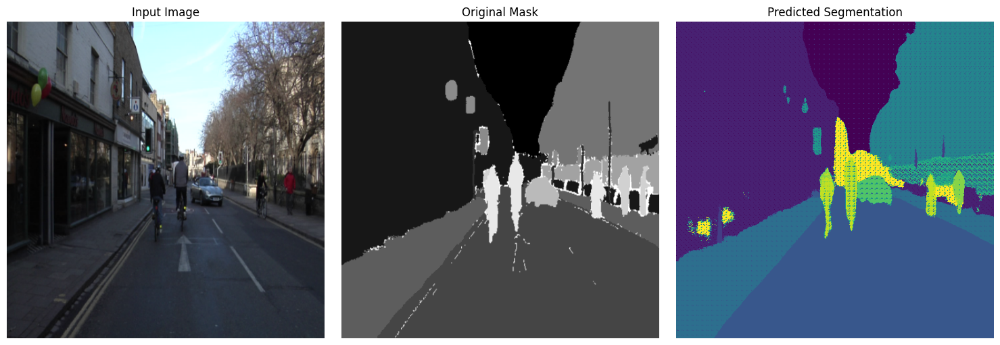

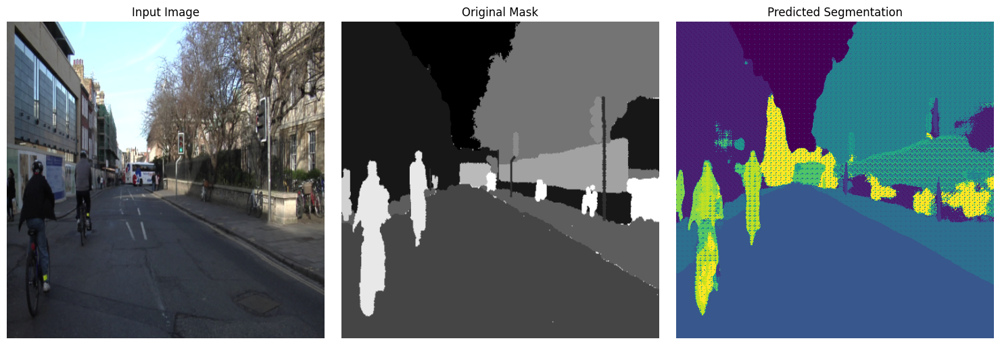

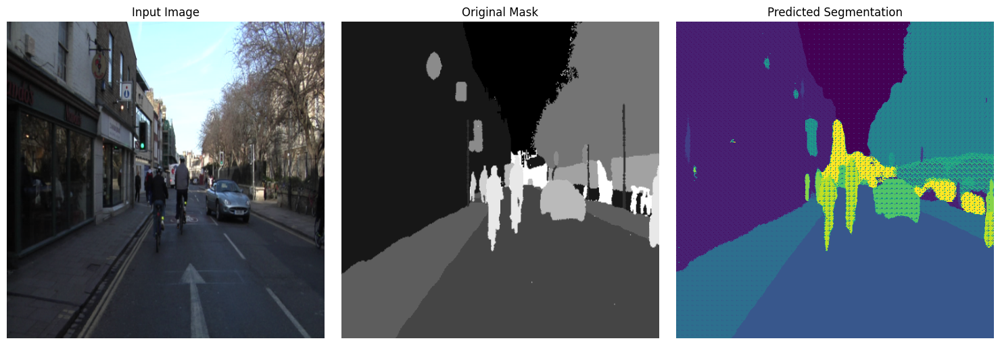

In [ ]:
infer_model = FCN8s_VGG(num_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "01_base_train_160", "fcn8s_vgg_160")

loaded_model, _, _, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "fcn8s_vgg", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

14B.Experiment FCN 8S VGG (320)

In [66]:
RUNS_DIR = '/content/drive/MyDrive/Experiment/Runs_Model'
CHECKPOINTS_DIR = '/content/drive/MyDrive/Experiment/Checkpoint_Model'
output_predictions = []

In [86]:
# Create model
fcn8s_vgg = FCN8s_VGG(num_classes=NUM_CLASSES)
fcn8s_vgg.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(fcn8s_vgg.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()
load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "01_base_train_160", "fcn8s_vgg_160")



In [87]:
loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


Loaded checkpoint from epoch 137 with best Dice Loss: 0.2892


In [88]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 320
last_best_epoch = loaded_epoch

experiment_name = "01_base_train_vgg_320"
model_name = "fcn8s_vgg_320"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": loaded_dice,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}



Directory created: /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/01_base_train_vgg_320/fcn8s_vgg_320


In [89]:
# Setup summary writer
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [90]:
run_training(model=fcn8s_vgg,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 138/320


Training:   0%|          | 0/46 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
Training:  22%|██▏       | 10/46 [00:01<00:03, 10.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:02<00:01, 16.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: 0.1219


Testing Loss: 0.9378
Epoch 139/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 23.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 140/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 141/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 142/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 19.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 23.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 143/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 144/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 145/320


Training:   4%|▍         | 2/46 [00:01<00:21,  2.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  24%|██▍       | 11/46 [00:01<00:02, 12.26it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 146/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 147/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 21.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 148/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 149/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 19.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 150/320


Training:   4%|▍         | 2/46 [00:01<00:22,  1.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 151/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 18.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 152/320


Training:   4%|▍         | 2/46 [00:01<00:20,  2.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 153/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 19.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 154/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 155/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 156/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 157/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 158/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 159/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 160/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 161/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 162/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 163/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 164/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 165/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 166/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 167/320


Training:   9%|▊         | 4/46 [00:01<00:09,  4.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 11.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 168/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 169/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 23.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 170/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  22%|██▏       | 10/46 [00:01<00:03, 10.37it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 23.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 171/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 172/320


Training:   9%|▊         | 4/46 [00:01<00:10,  4.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 173/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 18.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 174/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 175/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 176/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 23.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 177/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 178/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 179/320


Training:   4%|▍         | 2/46 [00:01<00:20,  2.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  7.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:01, 15.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 20.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 22.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 180/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 181/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:01, 15.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 19.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 20.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 182/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 17.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 183/320


Training:   7%|▋         | 3/46 [00:01<00:15,  2.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 184/320


Training:   9%|▊         | 4/46 [00:01<00:10,  4.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 185/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 186/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 187/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 21.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 23.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 188/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 189/320


Training:   9%|▊         | 4/46 [00:01<00:09,  4.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 19.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 23.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 190/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 11.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 191/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 192/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 193/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 194/320


Training:   4%|▍         | 2/46 [00:01<00:20,  2.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 23.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 195/320


Training:   9%|▊         | 4/46 [00:01<00:09,  4.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 19.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 196/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 197/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 198/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 199/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  9.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 11.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 200/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 201/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 202/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 203/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 204/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:08,  4.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03,  9.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 205/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  26%|██▌       | 12/46 [00:01<00:02, 12.66it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 206/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 207/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 208/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 18.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 209/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 210/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 211/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 20.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 212/320


Training:   7%|▋         | 3/46 [00:01<00:15,  2.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  8.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 213/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 214/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 215/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 216/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 22.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 217/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 218/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 23.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 219/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 220/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 221/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 222/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 223/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 224/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 19.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 225/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 226/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 227/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  6.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 228/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 229/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 230/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  9.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 12.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 231/320


Training:   9%|▊         | 4/46 [00:01<00:10,  4.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 22.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 232/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:01, 15.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 233/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 234/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 235/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 236/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 237/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 238/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 11.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 239/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 240/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 241/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 242/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 18.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 243/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 244/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 245/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 246/320


Training:   7%|▋         | 3/46 [00:01<00:15,  2.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 19.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 247/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 248/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 249/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 250/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 18.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 251/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 16.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 252/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 253/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 254/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 255/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 18.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 256/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:06,  6.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 15.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 257/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 258/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 259/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 260/320


Training:   9%|▊         | 4/46 [00:01<00:09,  4.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:01<00:01, 18.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 261/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 262/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 23.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 263/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 264/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:02<00:01, 16.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 265/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 266/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  15%|█▌        | 7/46 [00:01<00:04,  7.89it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 15.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:02<00:00, 23.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 267/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 268/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 269/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 270/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 20.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 271/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 272/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 273/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 274/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 275/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 276/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 277/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 278/320


Training:   7%|▋         | 3/46 [00:01<00:14,  2.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 20.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 279/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 280/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  9.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 281/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.18it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 282/320


Training:   9%|▊         | 4/46 [00:01<00:10,  4.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 11.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 17.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 283/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  28%|██▊       | 13/46 [00:01<00:02, 13.38it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:01<00:01, 17.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  61%|██████    | 28/46 [00:02<00:00, 21.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  93%|█████████▎| 43/46 [00:03<00:00, 22.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 284/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 22.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 285/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.70it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 19.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 21.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 23.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 286/320


Training:   4%|▍         | 2/46 [00:01<00:20,  2.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  7.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.98it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 287/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 16.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.



[INFO] NaN detected in loss, skipping update.
Training Loss: nan


Testing Loss: 0.9378
Epoch 288/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 12.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.25it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 289/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  8.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 290/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 291/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 21.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 21.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 292/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  26%|██▌       | 12/46 [00:01<00:02, 12.18it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.42it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 293/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.63it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.03it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 294/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.13it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 13.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 295/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.69it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:03<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 296/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.29it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.58it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 297/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 298/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.05it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.57it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.88it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 299/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  50%|█████     | 23/46 [00:02<00:01, 19.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  83%|████████▎ | 38/46 [00:02<00:00, 22.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 300/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.22it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 10.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 301/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.75it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 302/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.33it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.97it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 303/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.51it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 304/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  11%|█         | 5/46 [00:01<00:07,  5.30it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.49it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 305/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.28it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.55it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 306/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  17%|█▋        | 8/46 [00:01<00:04,  8.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.67it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.84it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 307/320


Training:   7%|▋         | 3/46 [00:01<00:12,  3.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  13%|█▎        | 6/46 [00:01<00:05,  6.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03,  9.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 13.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:01, 19.76it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.02it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.10it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 308/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  41%|████▏     | 19/46 [00:02<00:01, 17.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  74%|███████▍  | 34/46 [00:02<00:00, 22.24it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 22.93it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 309/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:01<00:01, 18.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.87it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 310/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.73it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

Training:  26%|██▌       | 12/46 [00:01<00:02, 13.13it/s]



[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  39%|███▉      | 18/46 [00:01<00:01, 17.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  72%|███████▏  | 33/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:02<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.78it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 311/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.17it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.68it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.15it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.85it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.41it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 312/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.09it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 16.36it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 19.34it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 20.21it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 22.06it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.35it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 313/320


Training:   7%|▋         | 3/46 [00:01<00:15,  2.86it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  6.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:04,  8.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:02<00:02, 13.71it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 16.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 18.56it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 20.82it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.12it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:03<00:00, 22.47it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 314/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.81it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.91it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 17.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.39it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 21.90it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.54it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.77it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 315/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.16it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:04,  7.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  30%|███       | 14/46 [00:01<00:02, 14.66it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 17.74it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  63%|██████▎   | 29/46 [00:02<00:00, 21.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.27it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.94it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 316/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.01it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.31it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  26%|██▌       | 12/46 [00:01<00:02, 12.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 15.46it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  59%|█████▊    | 27/46 [00:02<00:00, 20.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.52it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  91%|█████████▏| 42/46 [00:03<00:00, 22.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.89it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 317/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.19it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:02, 11.72it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.99it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.48it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.26it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.53it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.95it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 23.08it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 318/320


Training:   7%|▋         | 3/46 [00:01<00:13,  3.11it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.50it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  20%|█▉        | 9/46 [00:01<00:03,  9.32it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  33%|███▎      | 15/46 [00:01<00:02, 14.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  46%|████▌     | 21/46 [00:02<00:01, 18.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  52%|█████▏    | 24/46 [00:02<00:01, 19.43it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  65%|██████▌   | 30/46 [00:02<00:00, 21.14it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  78%|███████▊  | 36/46 [00:02<00:00, 21.79it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  85%|████████▍ | 39/46 [00:02<00:00, 22.00it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  98%|█████████▊| 45/46 [00:03<00:00, 22.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 319/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.07it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  24%|██▍       | 11/46 [00:01<00:03, 11.62it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  37%|███▋      | 17/46 [00:01<00:01, 16.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  43%|████▎     | 20/46 [00:02<00:01, 18.65it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  57%|█████▋    | 26/46 [00:02<00:00, 20.45it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  70%|██████▉   | 32/46 [00:02<00:00, 22.20it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  76%|███████▌  | 35/46 [00:02<00:00, 22.44it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  89%|████████▉ | 41/46 [00:02<00:00, 22.60it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  96%|█████████▌| 44/46 [00:03<00:00, 22.83it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
Epoch 320/320


Training:   7%|▋         | 3/46 [00:01<00:14,  3.04it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  15%|█▌        | 7/46 [00:01<00:05,  7.64it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  22%|██▏       | 10/46 [00:01<00:03, 10.80it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  35%|███▍      | 16/46 [00:01<00:01, 15.96it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  48%|████▊     | 22/46 [00:02<00:01, 18.92it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  54%|█████▍    | 25/46 [00:02<00:01, 19.37it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  67%|██████▋   | 31/46 [00:02<00:00, 21.59it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  80%|████████  | 37/46 [00:02<00:00, 22.40it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training:  87%|████████▋ | 40/46 [00:02<00:00, 22.61it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training: 100%|██████████| 46/46 [00:03<00:00, 23.23it/s]


[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.

[INFO] NaN detected in loss, skipping update.


Training Loss: nan


Testing Loss: 0.9378
[INFO] Finishing training with 183 epochs for 15.01 minutes
Training completed with best Dice Loss of 0.2892 at epoch 137


Loaded checkpoint from epoch 137 with best Dice Loss: 0.2892


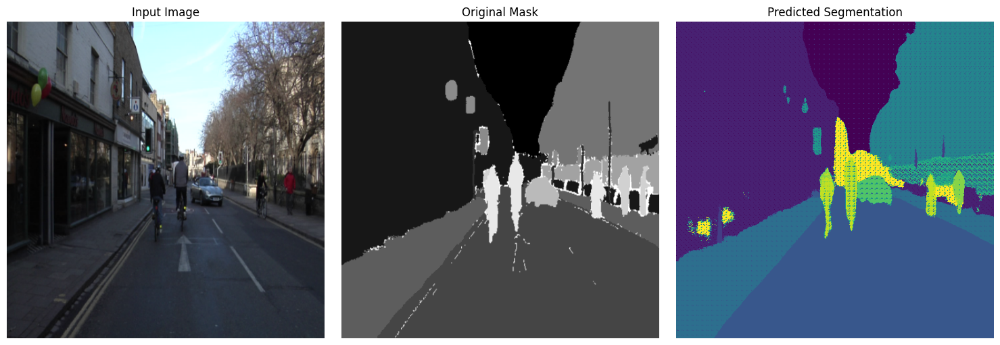

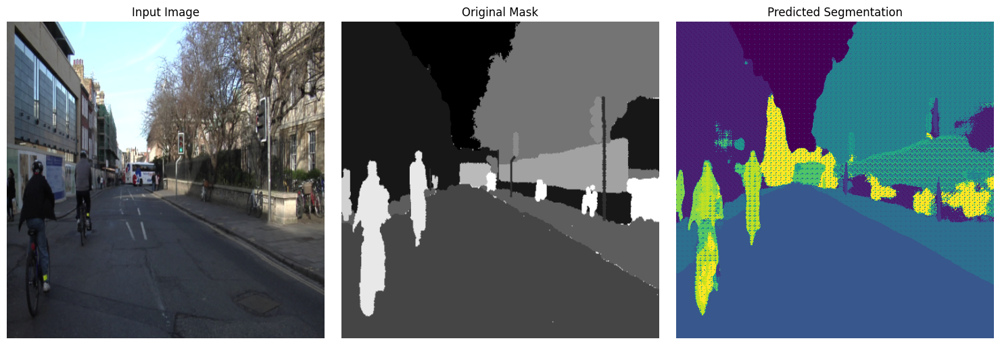

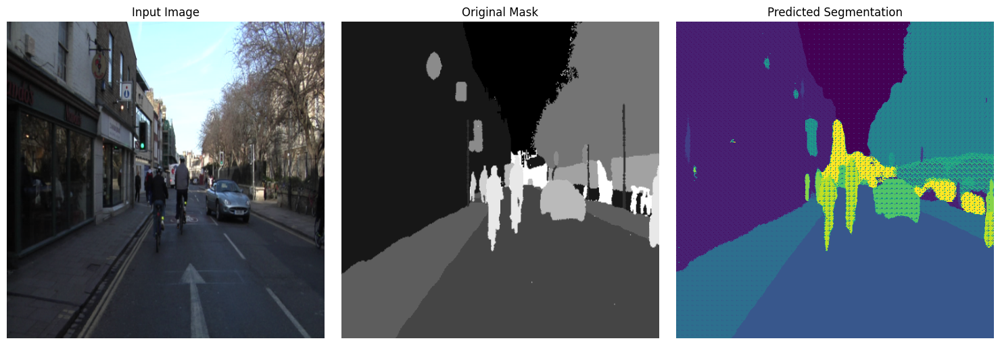

In [91]:
infer_model = FCN8s_VGG(num_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "01_base_train_160", "fcn8s_vgg_160")

loaded_model, _, _, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "fcn8s_vgg", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

15.Set Unet Model

In [92]:
# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

In [93]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
  """(convolution => [BN] => ReLU) * 2"""
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.double_conv = nn.Sequential(
      nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
      nn.BatchNorm2d(out_channels),
      nn.ReLU(inplace=True),
      nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
      nn.BatchNorm2d(out_channels),
      nn.ReLU(inplace=True)
    )

  def forward(self, x):
    return self.double_conv(x)

class Down(nn.Module):
  """Downscaling with maxpool then double conv"""
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.maxpool_conv = nn.Sequential(
      nn.MaxPool2d(2),
      DoubleConv(in_channels, out_channels)
    )

  def forward(self, x):
    return self.maxpool_conv(x)

class Up(nn.Module):
  """Upscaling then double conv"""
  def __init__(self, in_channels, out_channels, bilinear=True):
    super().__init__()
    if bilinear:
      self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
    else:
      self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

    self.conv = DoubleConv(in_channels, out_channels)

  def forward(self, x1, x2):
    x1 = self.up(x1)
    diffY = x2.size()[2] - x1.size()[2]
    diffX = x2.size()[3] - x1.size()[3]

    x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                    diffY // 2, diffY - diffY // 2])
    x = torch.cat([x2, x1], dim=1)
    return self.conv(x)

class OutConv(nn.Module):
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

  def forward(self, x):
    return self.conv(x)

class UNet(nn.Module):
  def __init__(self, n_channels, n_classes, bilinear=True):
    super(UNet, self).__init__()
    self.n_channels = n_channels
    self.n_classes = n_classes
    self.bilinear = bilinear

    self.inc = DoubleConv(n_channels, 64)
    self.down1 = Down(64, 128)
    self.down2 = Down(128, 256)
    self.down3 = Down(256, 512)
    self.down4 = Down(512, 1024 // 2)
    self.up1 = Up(1024, 512 // 2, bilinear)
    self.up2 = Up(512, 256 // 2, bilinear)
    self.up3 = Up(256, 128 // 2, bilinear)
    self.up4 = Up(128, 64, bilinear)
    self.outc = OutConv(64, n_classes)

  def forward(self, x):
    x1 = self.inc(x)
    x2 = self.down1(x1)
    x3 = self.down2(x2)
    x4 = self.down3(x3)
    x5 = self.down4(x4)
    x = self.up1(x5, x4)
    x = self.up2(x, x3)
    x = self.up3(x, x2)
    x = self.up4(x, x1)
    logits = self.outc(x)
    return logits


In [94]:
model_unet = UNet(n_channels=3, n_classes=NUM_CLASSES)
summary(model=model_unet,
        input_size=(1, 3, 512, 512),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
UNet (UNet)                                   [1, 3, 512, 512]     [1, 12, 512, 512]    --                   True
├─DoubleConv (inc)                            [1, 3, 512, 512]     [1, 64, 512, 512]    --                   True
│    └─Sequential (double_conv)               [1, 3, 512, 512]     [1, 64, 512, 512]    --                   True
│    │    └─Conv2d (0)                        [1, 3, 512, 512]     [1, 64, 512, 512]    1,792                True
│    │    └─BatchNorm2d (1)                   [1, 64, 512, 512]    [1, 64, 512, 512]    128                  True
│    │    └─ReLU (2)                          [1, 64, 512, 512]    [1, 64, 512, 512]    --                   --
│    │    └─Conv2d (3)                        [1, 64, 512, 512]    [1, 64, 512, 512]    36,928               True
│    │    └─BatchNorm2d (4)                   [1, 64, 512, 512]    [1, 64, 512, 512] 

In [95]:
# Create model
unet = UNet(n_channels=3, n_classes=NUM_CLASSES)
unet.to(device)

# Define loss function, optimizer, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(unet.parameters(), lr=0.001)
scaler = torch.cuda.amp.GradScaler()

15A.Experiment Unet (320)

In [96]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 320
last_best_epoch = 0

experiment_name = "03_base_train_unet_320"
model_name = "unet"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": 0.4,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}

Directory created: /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet


In [97]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [98]:
run_training(model=unet,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 1/320


Training Loss: 0.7977


Testing Loss: 0.7911
Epoch 2/320


Training Loss: 0.6923


Testing Loss: 0.7355
Epoch 3/320


Training Loss: 0.6390


Testing Loss: 0.7090
Epoch 4/320


Training Loss: 0.5930


Testing Loss: 0.6092
Epoch 5/320


Training Loss: 0.5684


Testing Loss: 0.5958
Epoch 6/320


Training Loss: 0.5551


Testing Loss: 0.5986
Epoch 7/320


Training Loss: 0.5370


Testing Loss: 0.5334
Epoch 8/320


Training Loss: 0.5237


Testing Loss: 0.5115
Epoch 9/320


Training Loss: 0.5205


Testing Loss: 0.5410
Epoch 10/320


Training Loss: 0.5086


Testing Loss: 0.5096
Epoch 11/320


Training Loss: 0.4907


Testing Loss: 0.5816
Epoch 12/320


Training Loss: 0.4925


Testing Loss: 0.6147
Epoch 13/320


Training Loss: 0.4871


Testing Loss: 0.4798
Epoch 14/320


Training Loss: 0.4780


Testing Loss: 0.4595
Epoch 15/320


Training Loss: 0.4761


Testing Loss: 0.4732
Epoch 16/320


Training Loss: 0.4712


Testing Loss: 0.4708
Epoch 17/320


Training Loss: 0.4586


Testing Loss: 0.4568
Epoch 18/320


Training Loss: 0.4634


Testing Loss: 0.4292
Epoch 19/320


Training Loss: 0.4493


Testing Loss: 0.4040
Epoch 20/320


Training Loss: 0.4382


Testing Loss: 0.4244
Epoch 21/320


Training Loss: 0.4326


Testing Loss: 0.4280
Epoch 22/320


Training Loss: 0.4283


Testing Loss: 0.4438
Epoch 23/320


Training Loss: 0.4220


Testing Loss: 0.4022
Epoch 24/320


Training Loss: 0.4173


Testing Loss: 0.4662
Epoch 25/320


Training Loss: 0.4233


Testing Loss: 0.4107
Epoch 26/320


Training Loss: 0.4144


Testing Loss: 0.3920
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 27/320


Training Loss: 0.4106


Testing Loss: 0.4143
Epoch 28/320


Training Loss: 0.4048


Testing Loss: 0.4267
Epoch 29/320


Training Loss: 0.3943


Testing Loss: 0.4040
Epoch 30/320


Training Loss: 0.3935


Testing Loss: 0.4300
Epoch 31/320


Training Loss: 0.3889


Testing Loss: 0.3908
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 32/320


Training Loss: 0.3853


Testing Loss: 0.3985
Epoch 33/320


Training Loss: 0.3730


Testing Loss: 0.4459
Epoch 34/320


Training Loss: 0.3763


Testing Loss: 0.3730
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 35/320


Training Loss: 0.3729


Testing Loss: 0.3697
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 36/320


Training Loss: 0.3718


Testing Loss: 0.4147
Epoch 37/320


Training Loss: 0.3661


Testing Loss: 0.3924
Epoch 38/320


Training Loss: 0.3665


Testing Loss: 0.3707
Epoch 39/320


Training Loss: 0.3578


Testing Loss: 0.3897
Epoch 40/320


Training Loss: 0.3549


Testing Loss: 0.3758
Epoch 41/320


Training Loss: 0.3496


Testing Loss: 0.3493
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 42/320


Training Loss: 0.3501


Testing Loss: 0.3563
Epoch 43/320


Training Loss: 0.3504


Testing Loss: 0.3507
Epoch 44/320


Training Loss: 0.3451


Testing Loss: 0.3596
Epoch 45/320


Training Loss: 0.3420


Testing Loss: 0.3878
Epoch 46/320


Training Loss: 0.3367


Testing Loss: 0.3317
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 47/320


Training Loss: 0.3278


Testing Loss: 0.3973
Epoch 48/320


Training Loss: 0.3345


Testing Loss: 0.3830
Epoch 49/320


Training Loss: 0.3320


Testing Loss: 0.4302
Epoch 50/320


Training Loss: 0.3321


Testing Loss: 0.3479
Epoch 51/320


Training Loss: 0.3232


Testing Loss: 0.3308
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 52/320


Training Loss: 0.3243


Testing Loss: 0.3285
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 53/320


Training Loss: 0.3185


Testing Loss: 0.3817
Epoch 54/320


Training Loss: 0.3252


Testing Loss: 0.3301
Epoch 55/320


Training Loss: 0.3174


Testing Loss: 0.3884
Epoch 56/320


Training Loss: 0.3143


Testing Loss: 0.3043
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 57/320


Training Loss: 0.3133


Testing Loss: 0.3297
Epoch 58/320


Training Loss: 0.3060


Testing Loss: 0.3160
Epoch 59/320


Training Loss: 0.3023


Testing Loss: 0.3578
Epoch 60/320


Training Loss: 0.2975


Testing Loss: 0.3328
Epoch 61/320


Training Loss: 0.3001


Testing Loss: 0.3351
Epoch 62/320


Training Loss: 0.3081


Testing Loss: 0.3161
Epoch 63/320


Training Loss: 0.3056


Testing Loss: 0.3459
Epoch 64/320


Training Loss: 0.2951


Testing Loss: 0.3499
Epoch 65/320


Training Loss: 0.2904


Testing Loss: 0.3249
Epoch 66/320


Training Loss: 0.2897


Testing Loss: 0.3418
Epoch 67/320


Training Loss: 0.2849


Testing Loss: 0.3554
Epoch 68/320


Training Loss: 0.2888


Testing Loss: 0.3145
Epoch 69/320


Training Loss: 0.2883


Testing Loss: 0.3119
Epoch 70/320


Training Loss: 0.2829


Testing Loss: 0.3136
Epoch 71/320


Training Loss: 0.2829


Testing Loss: 0.3592
Epoch 72/320


Training Loss: 0.2820


Testing Loss: 0.3315
Epoch 73/320


Training Loss: 0.2830


Testing Loss: 0.3145
Epoch 74/320


Training Loss: 0.2764


Testing Loss: 0.3481
Epoch 75/320


Training Loss: 0.2760


Testing Loss: 0.2887
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 76/320


Training Loss: 0.2842


Testing Loss: 0.3529
Epoch 77/320


Training Loss: 0.2799


Testing Loss: 0.3191
Epoch 78/320


Training Loss: 0.2693


Testing Loss: 0.3008
Epoch 79/320


Training Loss: 0.2658


Testing Loss: 0.3096
Epoch 80/320


Training Loss: 0.2667


Testing Loss: 0.3240
Epoch 81/320


Training Loss: 0.2654


Testing Loss: 0.2917
Epoch 82/320


Training Loss: 0.2672


Testing Loss: 0.3002
Epoch 83/320


Training Loss: 0.2629


Testing Loss: 0.3361
Epoch 84/320


Training Loss: 0.2590


Testing Loss: 0.3057
Epoch 85/320


Training Loss: 0.2557


Testing Loss: 0.3239
Epoch 86/320


Training Loss: 0.2616


Testing Loss: 0.3393
Epoch 87/320


Training Loss: 0.2629


Testing Loss: 0.3386
Epoch 88/320


Training Loss: 0.2618


Testing Loss: 0.3132
Epoch 89/320


Training Loss: 0.2661


Testing Loss: 0.3242
Epoch 90/320


Training Loss: 0.2592


Testing Loss: 0.3482
Epoch 91/320


Training Loss: 0.2602


Testing Loss: 0.3153
Epoch 92/320


Training Loss: 0.2564


Testing Loss: 0.2991
Epoch 93/320


Training Loss: 0.2523


Testing Loss: 0.3337
Epoch 94/320


Training Loss: 0.2529


Testing Loss: 0.2887
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 95/320


Training Loss: 0.2492


Testing Loss: 0.2629
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 96/320


Training Loss: 0.2464


Testing Loss: 0.2959
Epoch 97/320


Training Loss: 0.2470


Testing Loss: 0.2893
Epoch 98/320


Training Loss: 0.2417


Testing Loss: 0.2540
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 99/320


Training Loss: 0.2436


Testing Loss: 0.2982
Epoch 100/320


Training Loss: 0.2521


Testing Loss: 0.3331
Epoch 101/320


Training Loss: 0.2452


Testing Loss: 0.2896
Epoch 102/320


Training Loss: 0.2408


Testing Loss: 0.2657
Epoch 103/320


Training Loss: 0.2420


Testing Loss: 0.2832
Epoch 104/320


Training Loss: 0.2411


Testing Loss: 0.2945
Epoch 105/320


Training Loss: 0.2352


Testing Loss: 0.2663
Epoch 106/320


Training Loss: 0.2370


Testing Loss: 0.2813
Epoch 107/320


Training Loss: 0.2378


Testing Loss: 0.3028
Epoch 108/320


Training Loss: 0.2370


Testing Loss: 0.2722
Epoch 109/320


Training Loss: 0.2380


Testing Loss: 0.2751
Epoch 110/320


Training Loss: 0.2385


Testing Loss: 0.2837
Epoch 111/320


Training Loss: 0.2482


Testing Loss: 0.3373
Epoch 112/320


Training Loss: 0.2416


Testing Loss: 0.3086
Epoch 113/320


Training Loss: 0.2349


Testing Loss: 0.2759
Epoch 114/320


Training Loss: 0.2385


Testing Loss: 0.2780
Epoch 115/320


Training Loss: 0.2303


Testing Loss: 0.2730
Epoch 116/320


Training Loss: 0.2302


Testing Loss: 0.2865
Epoch 117/320


Training Loss: 0.2281


Testing Loss: 0.2917
Epoch 118/320


Training Loss: 0.2309


Testing Loss: 0.2716
Epoch 119/320


Training Loss: 0.2301


Testing Loss: 0.2780
Epoch 120/320


Training Loss: 0.2284


Testing Loss: 0.2720
Epoch 121/320


Training Loss: 0.2220


Testing Loss: 0.2872
Epoch 122/320


Training Loss: 0.2250


Testing Loss: 0.2756
Epoch 123/320


Training Loss: 0.2237


Testing Loss: 0.2693
Epoch 124/320


Training Loss: 0.2248


Testing Loss: 0.2844
Epoch 125/320


Training Loss: 0.2245


Testing Loss: 0.2621
Epoch 126/320


Training Loss: 0.2226


Testing Loss: 0.2782
Epoch 127/320


Training Loss: 0.2256


Testing Loss: 0.2667
Epoch 128/320


Training Loss: 0.2207


Testing Loss: 0.2715
Epoch 129/320


Training Loss: 0.2232


Testing Loss: 0.2637
Epoch 130/320


Training Loss: 0.2213


Testing Loss: 0.2606
Epoch 131/320


Training Loss: 0.2185


Testing Loss: 0.2866
Epoch 132/320


Training Loss: 0.2225


Testing Loss: 0.2714
Epoch 133/320


Training Loss: 0.2227


Testing Loss: 0.2799
Epoch 134/320


Training Loss: 0.2184


Testing Loss: 0.2666
Epoch 135/320


Training Loss: 0.2164


Testing Loss: 0.2694
Epoch 136/320


Training Loss: 0.2149


Testing Loss: 0.2819
Epoch 137/320


Training Loss: 0.2159


Testing Loss: 0.2886
Epoch 138/320


Training Loss: 0.2126


Testing Loss: 0.2668
Epoch 139/320


Training Loss: 0.2161


Testing Loss: 0.2721
Epoch 140/320


Training Loss: 0.2139


Testing Loss: 0.2692
Epoch 141/320


Training Loss: 0.2227


Testing Loss: 0.2832
Epoch 142/320


Training Loss: 0.2207


Testing Loss: 0.2485
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 143/320


Training Loss: 0.2354


Testing Loss: 0.2999
Epoch 144/320


Training Loss: 0.2334


Testing Loss: 0.2811
Epoch 145/320


Training Loss: 0.2329


Testing Loss: 0.2635
Epoch 146/320


Training Loss: 0.2193


Testing Loss: 0.2852
Epoch 147/320


Training Loss: 0.2180


Testing Loss: 0.2702
Epoch 148/320


Training Loss: 0.2122


Testing Loss: 0.2731
Epoch 149/320


Training Loss: 0.2179


Testing Loss: 0.2608
Epoch 150/320


Training Loss: 0.2101


Testing Loss: 0.2642
Epoch 151/320


Training Loss: 0.2107


Testing Loss: 0.2718
Epoch 152/320


Training Loss: 0.2115


Testing Loss: 0.2774
Epoch 153/320


Training Loss: 0.2082


Testing Loss: 0.2734
Epoch 154/320


Training Loss: 0.2076


Testing Loss: 0.2701
Epoch 155/320


Training Loss: 0.2085


Testing Loss: 0.2858
Epoch 156/320


Training Loss: 0.2074


Testing Loss: 0.2695
Epoch 157/320


Training Loss: 0.2065


Testing Loss: 0.2709
Epoch 158/320


Training Loss: 0.2075


Testing Loss: 0.2527
Epoch 159/320


Training Loss: 0.2045


Testing Loss: 0.2600
Epoch 160/320


Training Loss: 0.2062


Testing Loss: 0.2758
Epoch 161/320


Training Loss: 0.2044


Testing Loss: 0.2754
Epoch 162/320


Training Loss: 0.2038


Testing Loss: 0.2800
Epoch 163/320


Training Loss: 0.2070


Testing Loss: 0.2767
Epoch 164/320


Training Loss: 0.2059


Testing Loss: 0.2731
Epoch 165/320


Training Loss: 0.2084


Testing Loss: 0.2910
Epoch 166/320


Training Loss: 0.2148


Testing Loss: 0.2671
Epoch 167/320


Training Loss: 0.2242


Testing Loss: 0.2784
Epoch 168/320


Training Loss: 0.2169


Testing Loss: 0.2732
Epoch 169/320


Training Loss: 0.2081


Testing Loss: 0.2784
Epoch 170/320


Training Loss: 0.2093


Testing Loss: 0.2872
Epoch 171/320


Training Loss: 0.2079


Testing Loss: 0.2609
Epoch 172/320


Training Loss: 0.2088


Testing Loss: 0.2820
Epoch 173/320


Training Loss: 0.1997


Testing Loss: 0.2690
Epoch 174/320


Training Loss: 0.1982


Testing Loss: 0.2542
Epoch 175/320


Training Loss: 0.2024


Testing Loss: 0.2608
Epoch 176/320


Training Loss: 0.1972


Testing Loss: 0.2754
Epoch 177/320


Training Loss: 0.2044


Testing Loss: 0.2713
Epoch 178/320


Training Loss: 0.2033


Testing Loss: 0.2857
Epoch 179/320


Training Loss: 0.1994


Testing Loss: 0.2550
Epoch 180/320


Training Loss: 0.1994


Testing Loss: 0.2523
Epoch 181/320


Training Loss: 0.1987


Testing Loss: 0.2490
Epoch 182/320


Training Loss: 0.2006


Testing Loss: 0.2699
Epoch 183/320


Training Loss: 0.1997


Testing Loss: 0.2625
Epoch 184/320


Training Loss: 0.1971


Testing Loss: 0.2669
Epoch 185/320


Training Loss: 0.1975


Testing Loss: 0.2628
Epoch 186/320


Training Loss: 0.2029


Testing Loss: 0.2758
Epoch 187/320


Training Loss: 0.1974


Testing Loss: 0.2483
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_unet_320/unet

Epoch 188/320


Training Loss: 0.1955


Testing Loss: 0.2814
Epoch 189/320


Training Loss: 0.1954


Testing Loss: 0.2638
Epoch 190/320


Training Loss: 0.1973


Testing Loss: 0.2727
Epoch 191/320


Training Loss: 0.2007


Testing Loss: 0.2895
Epoch 192/320


Training Loss: 0.1992


Testing Loss: 0.2678
Epoch 193/320


Training Loss: 0.1973


Testing Loss: 0.2644
Epoch 194/320


Training Loss: 0.1982


Testing Loss: 0.2635
Epoch 195/320


Training Loss: 0.2006


Testing Loss: 0.2663
Epoch 196/320


Training Loss: 0.1968


Testing Loss: 0.2657
Epoch 197/320


Training Loss: 0.1947


Testing Loss: 0.2823
Epoch 198/320


Training Loss: 0.1933


Testing Loss: 0.2636
Epoch 199/320


Training Loss: 0.1951


Testing Loss: 0.2644
Epoch 200/320


Training Loss: 0.1934


Testing Loss: 0.2759
Epoch 201/320


Training Loss: 0.1912


Testing Loss: 0.2708
Epoch 202/320


Training Loss: 0.1930


Testing Loss: 0.2731
Epoch 203/320


Training Loss: 0.1944


Testing Loss: 0.2573
Epoch 204/320


Training Loss: 0.1939


Testing Loss: 0.2737
Epoch 205/320


Training Loss: 0.1969


Testing Loss: 0.2579
Epoch 206/320


Training Loss: 0.1923


Testing Loss: 0.2762
Epoch 207/320


Training Loss: 0.1936


Testing Loss: 0.2716
Epoch 208/320


Training Loss: 0.1973


Testing Loss: 0.2646
Epoch 209/320


Training Loss: 0.1927


Testing Loss: 0.2631
Epoch 210/320


Training Loss: 0.1985


Testing Loss: 0.2689
Epoch 211/320


Training Loss: 0.1923


Testing Loss: 0.2797
Epoch 212/320


Training Loss: 0.1893


Testing Loss: 0.2666
Epoch 213/320


Training Loss: 0.1925


Testing Loss: 0.2801
Epoch 214/320


Training Loss: 0.1974


Testing Loss: 0.2570
Epoch 215/320


Training Loss: 0.1903


Testing Loss: 0.2737
Epoch 216/320


Training Loss: 0.1927


Testing Loss: 0.2529
Epoch 217/320


Training Loss: 0.1902


Testing Loss: 0.2564
Epoch 218/320


Training Loss: 0.1854


Testing Loss: 0.2699
Epoch 219/320


Training Loss: 0.1965


Testing Loss: 0.2789
Epoch 220/320


Training Loss: 0.1970


Testing Loss: 0.2641
Epoch 221/320


Training Loss: 0.1919


Testing Loss: 0.2784
Epoch 222/320


Training Loss: 0.1907


Testing Loss: 0.2662
Epoch 223/320


Training Loss: 0.1929


Testing Loss: 0.2770
Epoch 224/320


Training Loss: 0.1913


Testing Loss: 0.2732
Epoch 225/320


Training Loss: 0.1892


Testing Loss: 0.2740
Epoch 226/320


Training Loss: 0.1887


Testing Loss: 0.2605
Epoch 227/320


Training Loss: 0.1884


Testing Loss: 0.2673
Epoch 228/320


Training Loss: 0.1840


Testing Loss: 0.2586
Epoch 229/320


Training Loss: 0.1872


Testing Loss: 0.2543
Epoch 230/320


Training Loss: 0.1852


Testing Loss: 0.2654
Epoch 231/320


Training Loss: 0.1897


Testing Loss: 0.3018
Epoch 232/320


Training Loss: 0.1915


Testing Loss: 0.2782
Epoch 233/320


Training Loss: 0.1879


Testing Loss: 0.2698
Epoch 234/320


Training Loss: 0.1804


Testing Loss: 0.2845
Epoch 235/320


Training Loss: 0.1829


Testing Loss: 0.2627
Epoch 236/320


Training Loss: 0.1822


Testing Loss: 0.2514
Epoch 237/320


Training Loss: 0.1802


Testing Loss: 0.2556
Epoch 238/320


Training Loss: 0.1841


Testing Loss: 0.2582
Epoch 239/320


Training Loss: 0.1843


Testing Loss: 0.2594
Epoch 240/320


Training Loss: 0.1816


Testing Loss: 0.2584
Epoch 241/320


Training Loss: 0.1848


Testing Loss: 0.2583
Epoch 242/320


Training Loss: 0.1822


Testing Loss: 0.2730
Epoch 243/320


Training Loss: 0.1850


Testing Loss: 0.2787
Epoch 244/320


Training Loss: 0.1862


Testing Loss: 0.2690
Epoch 245/320


Training Loss: 0.1847


Testing Loss: 0.2568
Epoch 246/320


Training Loss: 0.1829


Testing Loss: 0.2542
Epoch 247/320


Training Loss: 0.1847


Testing Loss: 0.2744
Epoch 248/320


Training Loss: 0.1888


Testing Loss: 0.2989
Epoch 249/320


Training Loss: 0.1876


Testing Loss: 0.2559
Epoch 250/320


Training Loss: 0.1819


Testing Loss: 0.2615
Epoch 251/320


Training Loss: 0.1842


Testing Loss: 0.2651
Epoch 252/320


Training Loss: 0.1826


Testing Loss: 0.2586
Epoch 253/320


Training Loss: 0.1835


Testing Loss: 0.2794
Epoch 254/320


Training Loss: 0.1864


Testing Loss: 0.2774
Epoch 255/320


Training Loss: 0.1845


Testing Loss: 0.2566
Epoch 256/320


Training Loss: 0.1820


Testing Loss: 0.2666
Epoch 257/320


Training Loss: 0.1796


Testing Loss: 0.2817
Epoch 258/320


Training Loss: 0.1825


Testing Loss: 0.2612
Epoch 259/320


Training Loss: 0.1779


Testing Loss: 0.2575
Epoch 260/320


Training Loss: 0.1824


Testing Loss: 0.2680
Epoch 261/320


Training Loss: 0.1841


Testing Loss: 0.2692
Epoch 262/320


Training Loss: 0.1795


Testing Loss: 0.2693
Epoch 263/320


Training Loss: 0.1813


Testing Loss: 0.2613
Epoch 264/320


Training Loss: 0.1793


Testing Loss: 0.2539
Epoch 265/320


Training Loss: 0.1811


Testing Loss: 0.2766
Epoch 266/320


Training Loss: 0.1797


Testing Loss: 0.2817
Epoch 267/320


Training Loss: 0.1810


Testing Loss: 0.2513
Epoch 268/320


Training Loss: 0.1788


Testing Loss: 0.2727
Epoch 269/320


Training Loss: 0.1814


Testing Loss: 0.2637
Epoch 270/320


Training Loss: 0.1753


Testing Loss: 0.2651
Epoch 271/320


Training Loss: 0.1766


Testing Loss: 0.2714
Epoch 272/320


Training Loss: 0.1769


Testing Loss: 0.2658
Epoch 273/320


Training Loss: 0.1793


Testing Loss: 0.2708
Epoch 274/320


Training Loss: 0.1810


Testing Loss: 0.2615
Epoch 275/320


Training Loss: 0.1741


Testing Loss: 0.2702
Epoch 276/320


Training Loss: 0.1816


Testing Loss: 0.2594
Epoch 277/320


Training Loss: 0.1749


Testing Loss: 0.2564
Epoch 278/320


Training Loss: 0.1791


Testing Loss: 0.2731
Epoch 279/320


Training Loss: 0.1820


Testing Loss: 0.2944
Epoch 280/320


Training Loss: 0.1806


Testing Loss: 0.2652
Epoch 281/320


Training Loss: 0.1788


Testing Loss: 0.2635
Epoch 282/320


Training Loss: 0.1777


Testing Loss: 0.2509
Epoch 283/320


Training Loss: 0.1766


Testing Loss: 0.2505
Epoch 284/320


Training Loss: 0.1758


Testing Loss: 0.2604
Epoch 285/320


Training Loss: 0.1781


Testing Loss: 0.2653
Epoch 286/320


Training Loss: 0.1779


Testing Loss: 0.2592
Epoch 287/320


Training Loss: 0.1788


Testing Loss: 0.2829
Epoch 288/320


Training Loss: 0.1789


Testing Loss: 0.2487
Epoch 289/320


Training Loss: 0.1789


Testing Loss: 0.2598
Epoch 290/320


Training Loss: 0.1821


Testing Loss: 0.2805
Epoch 291/320


Training Loss: 0.1861


Testing Loss: 0.2658
Epoch 292/320


Training Loss: 0.1823


Testing Loss: 0.2632
Epoch 293/320


Training Loss: 0.1787


Testing Loss: 0.2572
Epoch 294/320


Training Loss: 0.1756


Testing Loss: 0.2702
Epoch 295/320


Training Loss: 0.1780


Testing Loss: 0.2585
Epoch 296/320


Training Loss: 0.1763


Testing Loss: 0.2553
Epoch 297/320


Training Loss: 0.1763


Testing Loss: 0.2509
Epoch 298/320


Training Loss: 0.1751


Testing Loss: 0.2546
Epoch 299/320


Training Loss: 0.1729


Testing Loss: 0.2525
Epoch 300/320


Training Loss: 0.1729


Testing Loss: 0.2547
Epoch 301/320


Training Loss: 0.1698


Testing Loss: 0.2618
Epoch 302/320


Training Loss: 0.1755


Testing Loss: 0.2593
Epoch 303/320


Training Loss: 0.1744


Testing Loss: 0.2505
Epoch 304/320


Training Loss: 0.1703


Testing Loss: 0.2563
Epoch 305/320


Training Loss: 0.1743


Testing Loss: 0.2544
Epoch 306/320


Training Loss: 0.1712


Testing Loss: 0.2564
Epoch 307/320


Training Loss: 0.1695


Testing Loss: 0.2518
Epoch 308/320


Training Loss: 0.1726


Testing Loss: 0.2666
Epoch 309/320


Training Loss: 0.1690


Testing Loss: 0.2502
Epoch 310/320


Training Loss: 0.1717


Testing Loss: 0.2627
Epoch 311/320


Training Loss: 0.1695


Testing Loss: 0.2610
Epoch 312/320


Training Loss: 0.1740


Testing Loss: 0.2774
Epoch 313/320


Training Loss: 0.1698


Testing Loss: 0.2517
Epoch 314/320


Training Loss: 0.1680


Testing Loss: 0.2634
Epoch 315/320


Training Loss: 0.1680


Testing Loss: 0.2532
Epoch 316/320


Training Loss: 0.1731


Testing Loss: 0.2707
Epoch 317/320


Training Loss: 0.1727


Testing Loss: 0.2545
Epoch 318/320


Training Loss: 0.1753


Testing Loss: 0.2641
Epoch 319/320


Training Loss: 0.1740


Testing Loss: 0.2802
Epoch 320/320


Training Loss: 0.1723


Testing Loss: 0.2731
[INFO] Finishing training with 320 epochs for 64.87 minutes
Training completed with best Dice Loss of 0.2483 at epoch 187


Loaded checkpoint from epoch 187 with best Dice Loss: 0.2483


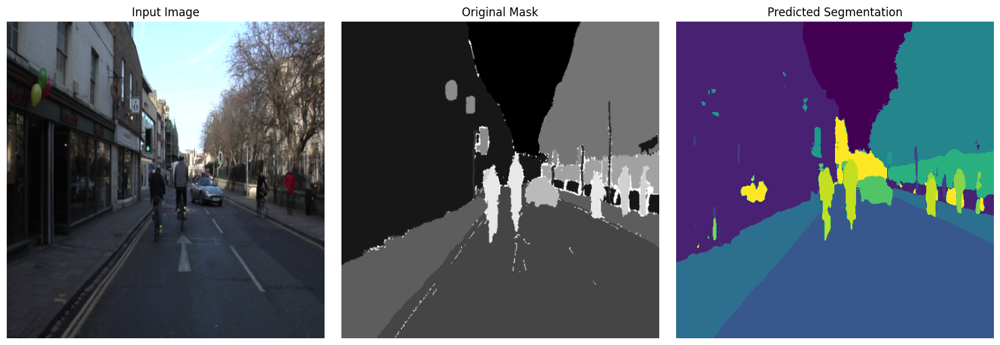

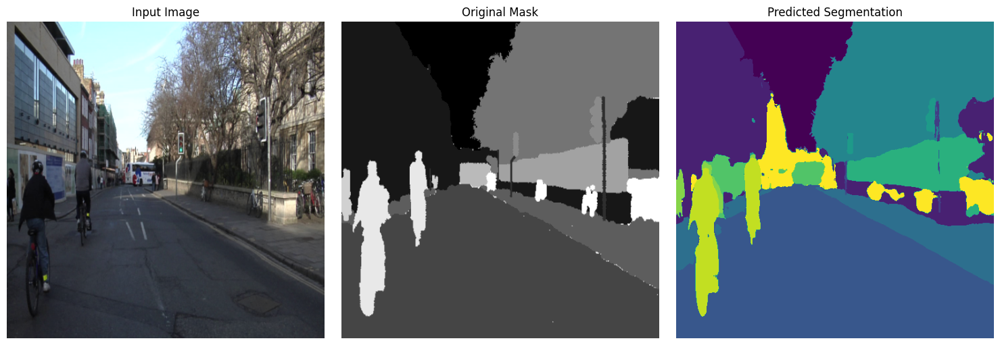

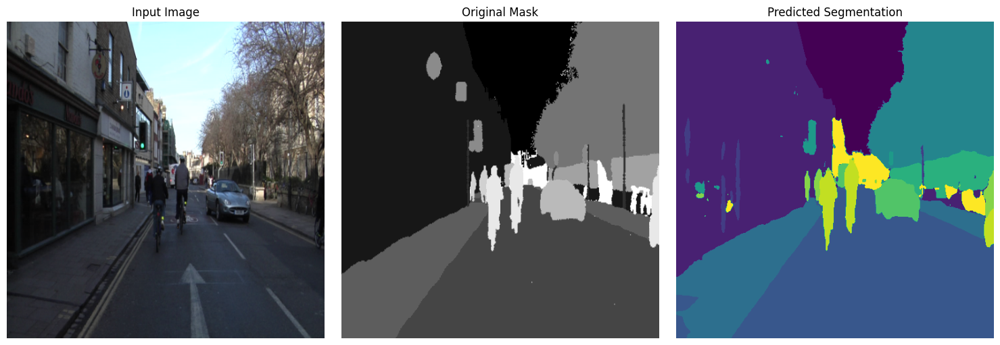

In [100]:
import os
infer_model = UNet(n_channels=3, n_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "03_base_train_unet_320", "unet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": experiment, "model": "unet", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

15B.Experiment Unet (480)

In [101]:
# Create model
unet = UNet(n_channels=3, n_classes=NUM_CLASSES)
unet.to(device)

# Define optimizer, loss function, and scaler
loss_fn = DiceLoss()
optimizer = torch.optim.Adam(unet.parameters())
scaler = torch.cuda.amp.GradScaler()

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "03_base_train_unet_320", "unet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=unet,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


Loaded checkpoint from epoch 187 with best Dice Loss: 0.2483


In [103]:
from datetime import datetime
timestamp = datetime.now().strftime("%Y-%m-%d")

train_until_epoch = 480
last_best_epoch = loaded_epoch

experiment_name = "03_base_train_480"
model_name = "unet"


logs_dir = os.path.join(RUNS_DIR, timestamp, experiment_name, model_name)
checkpoint_dir = os.path.join(CHECKPOINTS_DIR, timestamp, experiment_name, model_name)

if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
print(f"Directory created: {checkpoint_dir}")

EXPERIMENT = {
    "experiment_name": experiment_name,
    "model_name": model_name,
    "experiment_date": timestamp,
    "last_dice": loaded_dice,
    "train_until": train_until_epoch,
    "last_best_epoch": last_best_epoch,
    "num_epochs": train_until_epoch - last_best_epoch,
    "checkpoint_dir": checkpoint_dir
}

Directory created: /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_480/unet


In [104]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir=logs_dir)

In [105]:
run_training(model=unet,
             train_loader=train_dataloader,
             test_loader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             scaler=scaler,
             experiment=EXPERIMENT,
             writer=writer,
             device=device,
             num_classes=NUM_CLASSES)

Epoch 188/480


Training Loss: 0.1980


Testing Loss: 0.2796
Epoch 189/480


Training Loss: 0.2004


Testing Loss: 0.2819
Epoch 190/480


Training Loss: 0.1997


Testing Loss: 0.2629
Epoch 191/480


Training Loss: 0.1950


Testing Loss: 0.2619
Epoch 192/480


Training Loss: 0.1991


Testing Loss: 0.2759
Epoch 193/480


Training Loss: 0.1969


Testing Loss: 0.2785
Epoch 194/480


Training Loss: 0.1989


Testing Loss: 0.2531
Epoch 195/480


Training Loss: 0.1969


Testing Loss: 0.2843
Epoch 196/480


Training Loss: 0.2008


Testing Loss: 0.2592
Epoch 197/480


Training Loss: 0.1966


Testing Loss: 0.2654
Epoch 198/480


Training Loss: 0.1958


Testing Loss: 0.2694
Epoch 199/480


Training Loss: 0.1943


Testing Loss: 0.2489
Epoch 200/480


Training Loss: 0.1916


Testing Loss: 0.2551
Epoch 201/480


Training Loss: 0.1977


Testing Loss: 0.2597
Epoch 202/480


Training Loss: 0.1946


Testing Loss: 0.2851
Epoch 203/480


Training Loss: 0.1927


Testing Loss: 0.2839
Epoch 204/480


Training Loss: 0.2017


Testing Loss: 0.2754
Epoch 205/480


Training Loss: 0.1989


Testing Loss: 0.2806
Epoch 206/480


Training Loss: 0.1971


Testing Loss: 0.2494
Epoch 207/480


Training Loss: 0.1965


Testing Loss: 0.2538
Epoch 208/480


Training Loss: 0.1922


Testing Loss: 0.2699
Epoch 209/480


Training Loss: 0.1945


Testing Loss: 0.2566
Epoch 210/480


Training Loss: 0.1897


Testing Loss: 0.2711
Epoch 211/480


Training Loss: 0.1886


Testing Loss: 0.2626
Epoch 212/480


Training Loss: 0.1935


Testing Loss: 0.2835
Epoch 213/480


Training Loss: 0.1937


Testing Loss: 0.2628
Epoch 214/480


Training Loss: 0.1943


Testing Loss: 0.2492
Epoch 215/480


Training Loss: 0.1927


Testing Loss: 0.2997
Epoch 216/480


Training Loss: 0.1896


Testing Loss: 0.2730
Epoch 217/480


Training Loss: 0.1897


Testing Loss: 0.2598
Epoch 218/480


Training Loss: 0.1910


Testing Loss: 0.2680
Epoch 219/480


Training Loss: 0.1890


Testing Loss: 0.2660
Epoch 220/480


Training Loss: 0.1906


Testing Loss: 0.2852
Epoch 221/480


Training Loss: 0.1920


Testing Loss: 0.2684
Epoch 222/480


Training Loss: 0.1874


Testing Loss: 0.2628
Epoch 223/480


Training Loss: 0.1888


Testing Loss: 0.2530
Epoch 224/480


Training Loss: 0.1832


Testing Loss: 0.2624
Epoch 225/480


Training Loss: 0.1884


Testing Loss: 0.2668
Epoch 226/480


Training Loss: 0.1861


Testing Loss: 0.2568
Epoch 227/480


Training Loss: 0.1907


Testing Loss: 0.2657
Epoch 228/480


Training Loss: 0.1914


Testing Loss: 0.2847
Epoch 229/480


Training Loss: 0.1886


Testing Loss: 0.2662
Epoch 230/480


Training Loss: 0.1863


Testing Loss: 0.2668
Epoch 231/480


Training Loss: 0.1891


Testing Loss: 0.2653
Epoch 232/480


Training Loss: 0.1891


Testing Loss: 0.2795
Epoch 233/480


Training Loss: 0.1873


Testing Loss: 0.2898
Epoch 234/480


Training Loss: 0.1851


Testing Loss: 0.2699
Epoch 235/480


Training Loss: 0.1816


Testing Loss: 0.2624
Epoch 236/480


Training Loss: 0.1859


Testing Loss: 0.2553
Epoch 237/480


Training Loss: 0.1851


Testing Loss: 0.2799
Epoch 238/480


Training Loss: 0.1840


Testing Loss: 0.2574
Epoch 239/480


Training Loss: 0.1821


Testing Loss: 0.2563
Epoch 240/480


Training Loss: 0.1828


Testing Loss: 0.2507
Epoch 241/480


Training Loss: 0.1852


Testing Loss: 0.2625
Epoch 242/480


Training Loss: 0.1849


Testing Loss: 0.2734
Epoch 243/480


Training Loss: 0.1831


Testing Loss: 0.2551
Epoch 244/480


Training Loss: 0.1833


Testing Loss: 0.2762
Epoch 245/480


Training Loss: 0.1892


Testing Loss: 0.2613
Epoch 246/480


Training Loss: 0.1844


Testing Loss: 0.2533
Epoch 247/480


Training Loss: 0.1811


Testing Loss: 0.2634
Epoch 248/480


Training Loss: 0.1813


Testing Loss: 0.2599
Epoch 249/480


Training Loss: 0.1882


Testing Loss: 0.2843
Epoch 250/480


Training Loss: 0.1802


Testing Loss: 0.2545
Epoch 251/480


Training Loss: 0.1833


Testing Loss: 0.2666
Epoch 252/480


Training Loss: 0.1830


Testing Loss: 0.2892
Epoch 253/480


Training Loss: 0.1899


Testing Loss: 0.2574
Epoch 254/480


Training Loss: 0.1853


Testing Loss: 0.2605
Epoch 255/480


Training Loss: 0.1818


Testing Loss: 0.2725
Epoch 256/480


Training Loss: 0.1854


Testing Loss: 0.2674
Epoch 257/480


Training Loss: 0.1833


Testing Loss: 0.2801
Epoch 258/480


Training Loss: 0.1821


Testing Loss: 0.2785
Epoch 259/480


Training Loss: 0.1834


Testing Loss: 0.2731
Epoch 260/480


Training Loss: 0.1829


Testing Loss: 0.2662
Epoch 261/480


Training Loss: 0.1846


Testing Loss: 0.2573
Epoch 262/480


Training Loss: 0.1879


Testing Loss: 0.2612
Epoch 263/480


Training Loss: 0.1839


Testing Loss: 0.2530
Epoch 264/480


Training Loss: 0.1827


Testing Loss: 0.2628
Epoch 265/480


Training Loss: 0.1790


Testing Loss: 0.2563
Epoch 266/480


Training Loss: 0.1887


Testing Loss: 0.2701
Epoch 267/480


Training Loss: 0.1813


Testing Loss: 0.2748
Epoch 268/480


Training Loss: 0.1807


Testing Loss: 0.2670
Epoch 269/480


Training Loss: 0.1804


Testing Loss: 0.2600
Epoch 270/480


Training Loss: 0.1792


Testing Loss: 0.2643
Epoch 271/480


Training Loss: 0.1782


Testing Loss: 0.2654
Epoch 272/480


Training Loss: 0.1815


Testing Loss: 0.2606
Epoch 273/480


Training Loss: 0.1771


Testing Loss: 0.2656
Epoch 274/480


Training Loss: 0.1814


Testing Loss: 0.2831
Epoch 275/480


Training Loss: 0.1761


Testing Loss: 0.2767
Epoch 276/480


Training Loss: 0.1770


Testing Loss: 0.2611
Epoch 277/480


Training Loss: 0.1775


Testing Loss: 0.2672
Epoch 278/480


Training Loss: 0.1746


Testing Loss: 0.2573
Epoch 279/480


Training Loss: 0.1781


Testing Loss: 0.2522
Epoch 280/480


Training Loss: 0.1812


Testing Loss: 0.2662
Epoch 281/480


Training Loss: 0.1750


Testing Loss: 0.2574
Epoch 282/480


Training Loss: 0.1772


Testing Loss: 0.2619
Epoch 283/480


Training Loss: 0.1747


Testing Loss: 0.4040
Epoch 284/480


Training Loss: 0.1844


Testing Loss: 0.2597
Epoch 285/480


Training Loss: 0.1788


Testing Loss: 0.2690
Epoch 286/480


Training Loss: 0.1796


Testing Loss: 0.2731
Epoch 287/480


Training Loss: 0.1765


Testing Loss: 0.2569
Epoch 288/480


Training Loss: 0.1769


Testing Loss: 0.2615
Epoch 289/480


Training Loss: 0.1753


Testing Loss: 0.2584
Epoch 290/480


Training Loss: 0.1755


Testing Loss: 0.2633
Epoch 291/480


Training Loss: 0.1757


Testing Loss: 0.2610
Epoch 292/480


Training Loss: 0.1752


Testing Loss: 0.2740
Epoch 293/480


Training Loss: 0.1739


Testing Loss: 0.2569
Epoch 294/480


Training Loss: 0.1754


Testing Loss: 0.2725
Epoch 295/480


Training Loss: 0.1754


Testing Loss: 0.2707
Epoch 296/480


Training Loss: 0.1779


Testing Loss: 0.2543
Epoch 297/480


Training Loss: 0.1752


Testing Loss: 0.2604
Epoch 298/480


Training Loss: 0.1738


Testing Loss: 0.2500
Epoch 299/480


Training Loss: 0.1732


Testing Loss: 0.2553
Epoch 300/480


Training Loss: 0.1733


Testing Loss: 0.2710
Epoch 301/480


Training Loss: 0.1755


Testing Loss: 0.2623
Epoch 302/480


Training Loss: 0.1796


Testing Loss: 0.2811
Epoch 303/480


Training Loss: 0.1780


Testing Loss: 0.2629
Epoch 304/480


Training Loss: 0.1730


Testing Loss: 0.2614
Epoch 305/480


Training Loss: 0.1727


Testing Loss: 0.2569
Epoch 306/480


Training Loss: 0.1772


Testing Loss: 0.2705
Epoch 307/480


Training Loss: 0.1720


Testing Loss: 0.2670
Epoch 308/480


Training Loss: 0.1768


Testing Loss: 0.2613
Epoch 309/480


Training Loss: 0.1783


Testing Loss: 0.2766
Epoch 310/480


Training Loss: 0.1725


Testing Loss: 0.2449
[INFO] Creating model, optimizer, and scaler checkpoint...
[INFO] Checkpoint saved at /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01/03_base_train_480/unet

Epoch 311/480


Training Loss: 0.1732


Testing Loss: 0.2773
Epoch 312/480


Training Loss: 0.1728


Testing Loss: 0.2741
Epoch 313/480


Training Loss: 0.1731


Testing Loss: 0.2524
Epoch 314/480


Training Loss: 0.1742


Testing Loss: 0.2553
Epoch 315/480


Training Loss: 0.1710


Testing Loss: 0.2640
Epoch 316/480


Training Loss: 0.1766


Testing Loss: 0.2701
Epoch 317/480


Training Loss: 0.1720


Testing Loss: 0.2544
Epoch 318/480


Training Loss: 0.1714


Testing Loss: 0.2620
Epoch 319/480


Training Loss: 0.1760


Testing Loss: 0.2667
Epoch 320/480


Training Loss: 0.1674


Testing Loss: 0.2527
Epoch 321/480


Training Loss: 0.1727


Testing Loss: 0.2646
Epoch 322/480


Training Loss: 0.1688


Testing Loss: 0.2619
Epoch 323/480


Training Loss: 0.1701


Testing Loss: 0.2568
Epoch 324/480


Training Loss: 0.1705


Testing Loss: 0.2788
Epoch 325/480


Training Loss: 0.1746


Testing Loss: 0.2488
Epoch 326/480


Training Loss: 0.1703


Testing Loss: 0.2688
Epoch 327/480


Training Loss: 0.1683


Testing Loss: 0.2495
Epoch 328/480


Training Loss: 0.1674


Testing Loss: 0.2643
Epoch 329/480


Training Loss: 0.1710


Testing Loss: 0.2565
Epoch 330/480


Training Loss: 0.1682


Testing Loss: 0.2527
Epoch 331/480


Training Loss: 0.1668


Testing Loss: 0.2548
Epoch 332/480


Training Loss: 0.1719


Testing Loss: 0.2505
Epoch 333/480


Training Loss: 0.1705


Testing Loss: 0.2528
Epoch 334/480


Training Loss: 0.1704


Testing Loss: 0.2514
Epoch 335/480


Training Loss: 0.1671


Testing Loss: 0.2570
Epoch 336/480


Training Loss: 0.1699


Testing Loss: 0.2620
Epoch 337/480


Training Loss: 0.1677


Testing Loss: 0.2615
Epoch 338/480


Training Loss: 0.1707


Testing Loss: 0.2697
Epoch 339/480


Training Loss: 0.1690


Testing Loss: 0.2748
Epoch 340/480


Training Loss: 0.1720


Testing Loss: 0.2613
Epoch 341/480


Training Loss: 0.1695


Testing Loss: 0.2578
Epoch 342/480


Training Loss: 0.1678


Testing Loss: 0.2688
Epoch 343/480


Training Loss: 0.1700


Testing Loss: 0.2577
Epoch 344/480


Training Loss: 0.1688


Testing Loss: 0.2559
Epoch 345/480


Training Loss: 0.1702


Testing Loss: 0.2610
Epoch 346/480


Training Loss: 0.1703


Testing Loss: 0.2593
Epoch 347/480


Training Loss: 0.1670


Testing Loss: 0.2673
Epoch 348/480


Training Loss: 0.1670


Testing Loss: 0.2575
Epoch 349/480


Training Loss: 0.1694


Testing Loss: 0.2720
Epoch 350/480


Training Loss: 0.1690


Testing Loss: 0.2657
Epoch 351/480


Training Loss: 0.1647


Testing Loss: 0.2685
Epoch 352/480


Training Loss: 0.1641


Testing Loss: 0.2549
Epoch 353/480


Training Loss: 0.1658


Testing Loss: 0.2603
Epoch 354/480


Training Loss: 0.1685


Testing Loss: 0.2566
Epoch 355/480


Training Loss: 0.1690


Testing Loss: 0.2795
Epoch 356/480


Training Loss: 0.1662


Testing Loss: 0.2668
Epoch 357/480


Training Loss: 0.1677


Testing Loss: 0.2608
Epoch 358/480


Training Loss: 0.1690


Testing Loss: 0.2783
Epoch 359/480


Training Loss: 0.1689


Testing Loss: 0.2630
Epoch 360/480


Training Loss: 0.1654


Testing Loss: 0.2709
Epoch 361/480


Training Loss: 0.1686


Testing Loss: 0.3043
Epoch 362/480


Training Loss: 0.1686


Testing Loss: 0.2528
Epoch 363/480


Training Loss: 0.1700


Testing Loss: 0.2659
Epoch 364/480


Training Loss: 0.1679


Testing Loss: 0.2582
Epoch 365/480


Training Loss: 0.1712


Testing Loss: 0.2591
Epoch 366/480


Training Loss: 0.1666


Testing Loss: 0.2506
Epoch 367/480


Training Loss: 0.1665


Testing Loss: 0.2532
Epoch 368/480


Training Loss: 0.1654


Testing Loss: 0.2550
Epoch 369/480


Training Loss: 0.1672


Testing Loss: 0.2607
Epoch 370/480


Training Loss: 0.1686


Testing Loss: 0.2659
Epoch 371/480


Training Loss: 0.1652


Testing Loss: 0.2630
Epoch 372/480


Training Loss: 0.1650


Testing Loss: 0.2493
Epoch 373/480


Training Loss: 0.1649


Testing Loss: 0.2591
Epoch 374/480


Training Loss: 0.1632


Testing Loss: 0.2628
Epoch 375/480


Training Loss: 0.1671


Testing Loss: 0.2636
Epoch 376/480


Training Loss: 0.1687


Testing Loss: 0.2627
Epoch 377/480


Training Loss: 0.1686


Testing Loss: 0.2691
Epoch 378/480


Training Loss: 0.1645


Testing Loss: 0.2549
Epoch 379/480


Training Loss: 0.1671


Testing Loss: 0.2631
Epoch 380/480


Training Loss: 0.1650


Testing Loss: 0.2574
Epoch 381/480


Training Loss: 0.1625


Testing Loss: 0.2664
Epoch 382/480


Training Loss: 0.1626


Testing Loss: 0.2569
Epoch 383/480


Training Loss: 0.1707


Testing Loss: 0.2661
Epoch 384/480


Training Loss: 0.1665


Testing Loss: 0.2586
Epoch 385/480


Training Loss: 0.1658


Testing Loss: 0.2814
Epoch 386/480


Training Loss: 0.1643


Testing Loss: 0.2563
Epoch 387/480


Training Loss: 0.1675


Testing Loss: 0.2764
Epoch 388/480


Training Loss: 0.1642


Testing Loss: 0.2608
Epoch 389/480


Training Loss: 0.1639


Testing Loss: 0.2636
Epoch 390/480


Training Loss: 0.1614


Testing Loss: 0.2774
Epoch 391/480


Training Loss: 0.1626


Testing Loss: 0.2654
Epoch 392/480


Training Loss: 0.1625


Testing Loss: 0.2687
Epoch 393/480


Training Loss: 0.1612


Testing Loss: 0.2536
Epoch 394/480


Training Loss: 0.1641


Testing Loss: 0.2713
Epoch 395/480


Training Loss: 0.1633


Testing Loss: 0.2570
Epoch 396/480


Training Loss: 0.1590


Testing Loss: 0.2573
Epoch 397/480


Training Loss: 0.1640


Testing Loss: 0.2564
Epoch 398/480


Training Loss: 0.1622


Testing Loss: 0.2673
Epoch 399/480


Training Loss: 0.1632


Testing Loss: 0.2603
Epoch 400/480


Training Loss: 0.1665


Testing Loss: 0.2493
Epoch 401/480


Training Loss: 0.1598


Testing Loss: 0.2643
Epoch 402/480


Training Loss: 0.1606


Testing Loss: 0.2647
Epoch 403/480


Training Loss: 0.1628


Testing Loss: 0.2678
Epoch 404/480


Training Loss: 0.1609


Testing Loss: 0.2608
Epoch 405/480


Training Loss: 0.1625


Testing Loss: 0.2646
Epoch 406/480


Training Loss: 0.1627


Testing Loss: 0.2617
Epoch 407/480


Training Loss: 0.1629


Testing Loss: 0.2784
Epoch 408/480


Training Loss: 0.1651


Testing Loss: 0.2711
Epoch 409/480


Training Loss: 0.1608


Testing Loss: 0.2625
Epoch 410/480


Training Loss: 0.1614


Testing Loss: 0.2611
Epoch 411/480


Training Loss: 0.1621


Testing Loss: 0.2667
Epoch 412/480


Training Loss: 0.1627


Testing Loss: 0.2616
Epoch 413/480


Training Loss: 0.1591


Testing Loss: 0.2791
Epoch 414/480


Training Loss: 0.1623


Testing Loss: 0.2766
Epoch 415/480


Training Loss: 0.1585


Testing Loss: 0.2717
Epoch 416/480


Training Loss: 0.1592


Testing Loss: 0.2635
Epoch 417/480


Training Loss: 0.1588


Testing Loss: 0.2738
Epoch 418/480


Training Loss: 0.1631


Testing Loss: 0.2652
Epoch 419/480


Training Loss: 0.1588


Testing Loss: 0.2616
Epoch 420/480


Training Loss: 0.1617


Testing Loss: 0.2657
Epoch 421/480


Training Loss: 0.1557


Testing Loss: 0.2622
Epoch 422/480


Training Loss: 0.1619


Testing Loss: 0.2643
Epoch 423/480


Training Loss: 0.1634


Testing Loss: 0.2838
Epoch 424/480


Training Loss: 0.1625


Testing Loss: 0.2741
Epoch 425/480


Training Loss: 0.1577


Testing Loss: 0.2582
Epoch 426/480


Training Loss: 0.1613


Testing Loss: 0.2621
Epoch 427/480


Training Loss: 0.1571


Testing Loss: 0.2726
Epoch 428/480


Training Loss: 0.1635


Testing Loss: 0.2626
Epoch 429/480


Training Loss: 0.1644


Testing Loss: 0.2696
Epoch 430/480


Training Loss: 0.1597


Testing Loss: 0.2611
Epoch 431/480


Training Loss: 0.1580


Testing Loss: 0.2604
Epoch 432/480


Training Loss: 0.1572


Testing Loss: 0.2560
Epoch 433/480


Training Loss: 0.1584


Testing Loss: 0.2627
Epoch 434/480


Training Loss: 0.1579


Testing Loss: 0.2742
Epoch 435/480


Training Loss: 0.1589


Testing Loss: 0.2583
Epoch 436/480


Training Loss: 0.1571


Testing Loss: 0.2588
Epoch 437/480


Training Loss: 0.1594


Testing Loss: 0.2667
Epoch 438/480


Training Loss: 0.1580


Testing Loss: 0.2638
Epoch 439/480


Training Loss: 0.1594


Testing Loss: 0.2638
Epoch 440/480


Training Loss: 0.1577


Testing Loss: 0.2568
Epoch 441/480


Training Loss: 0.1578


Testing Loss: 0.2718
Epoch 442/480


Training Loss: 0.1562


Testing Loss: 0.2707
Epoch 443/480


Training Loss: 0.1600


Testing Loss: 0.2637
Epoch 444/480


Training Loss: 0.1562


Testing Loss: 0.2599
Epoch 445/480


Training Loss: 0.1552


Testing Loss: 0.2631
Epoch 446/480


Training Loss: 0.1572


Testing Loss: 0.2628
Epoch 447/480


Training Loss: 0.1577


Testing Loss: 0.2662
Epoch 448/480


Training Loss: 0.1595


Testing Loss: 0.2523
Epoch 449/480


Training Loss: 0.1579


Testing Loss: 0.2454
Epoch 450/480


Training Loss: 0.1585


Testing Loss: 0.2673
Epoch 451/480


Training Loss: 0.1557


Testing Loss: 0.2589
Epoch 452/480


Training Loss: 0.1618


Testing Loss: 0.2725
Epoch 453/480


Training Loss: 0.1553


Testing Loss: 0.2577
Epoch 454/480


Training Loss: 0.1613


Testing Loss: 0.2540
Epoch 455/480


Training Loss: 0.1569


Testing Loss: 0.2611
Epoch 456/480


Training Loss: 0.1538


Testing Loss: 0.2507
Epoch 457/480


Training Loss: 0.1602


Testing Loss: 0.2667
Epoch 458/480


Training Loss: 0.1561


Testing Loss: 0.2558
Epoch 459/480


Training Loss: 0.1554


Testing Loss: 0.2697
Epoch 460/480


Training Loss: 0.1567


Testing Loss: 0.2591
Epoch 461/480


Training Loss: 0.1561


Testing Loss: 0.2655
Epoch 462/480


Training Loss: 0.1571


Testing Loss: 0.2570
Epoch 463/480


Training Loss: 0.1578


Testing Loss: 0.2713
Epoch 464/480


Training Loss: 0.1552


Testing Loss: 0.2713
Epoch 465/480


Training Loss: 0.1600


Testing Loss: 0.2780
Epoch 466/480


Training Loss: 0.1555


Testing Loss: 0.2693
Epoch 467/480


Training Loss: 0.1592


Testing Loss: 0.2600
Epoch 468/480


Training Loss: 0.1610


Testing Loss: 0.2671
Epoch 469/480


Training Loss: 0.1551


Testing Loss: 0.2763
Epoch 470/480


Training Loss: 0.1573


Testing Loss: 0.2560
Epoch 471/480


Training Loss: 0.1554


Testing Loss: 0.2698
Epoch 472/480


Training Loss: 0.1588


Testing Loss: 0.2726
Epoch 473/480


Training Loss: 0.1558


Testing Loss: 0.2679
Epoch 474/480


Training Loss: 0.1543


Testing Loss: 0.2708
Epoch 475/480


Training Loss: 0.1571


Testing Loss: 0.2569
Epoch 476/480


Training Loss: 0.1588


Testing Loss: 0.2574
Epoch 477/480


Training Loss: 0.1549


Testing Loss: 0.2698
Epoch 478/480


Training Loss: 0.1526


Testing Loss: 0.2686
Epoch 479/480


Training Loss: 0.1581


Testing Loss: 0.2748
Epoch 480/480


Training Loss: 0.1552


Testing Loss: 0.2701
[INFO] Finishing training with 293 epochs for 61.48 minutes
Training completed with best Dice Loss of 0.2449 at epoch 310


In [ ]:
infer_model = UNet(n_channels=3, n_classes=NUM_CLASSES)
infer_model.to(device)

load_checkpoint_dir = os.path.join(CHECKPOINTS_DIR, "2024-05-01", "03_base_train_480", "unet")

loaded_model, loaded_optimizer, loaded_scaler, loaded_epoch, loaded_dice, loaded_experiment = load_checkpoint(
  model=infer_model,
  optimizer=optimizer,
  scaler=scaler,
  device=device,
  checkpoint_path=f"{load_checkpoint_dir}/checkpoint.pth",
  model_path=f"{load_checkpoint_dir}/best_model.pth"
)


output_tensors = infer_and_plot_dataloader(loaded_model, test_dataloader, device, 3)


experiment = loaded_experiment["experiment_name"]

output_prediction = {"tensors": output_tensors, "experiment": f"{experiment}_extended", "model": "unet", "best_dice": loaded_dice, "best_epoch": loaded_epoch}
output_predictions.append(output_prediction)

In [108]:
import matplotlib.pyplot as plt

def plot_tensors(outputs):
  # Calculate the total number of plots
  num_dicts = len(outputs)
  num_tensors = len(outputs[0]['tensors'])  # Assuming all dicts have the same number of tensors
  total_plots = num_dicts * num_tensors

  scale = 5
  # Set up the figure size dynamically
  fig, axes = plt.subplots(num_dicts, num_tensors, figsize=(num_tensors * scale, num_dicts * scale))

  # Flatten axes array for easy iteration if there are multiple rows
  if num_dicts > 1:
    axes = axes.flatten()

  # Iterate over each dictionary and each tensor
  for i, output_dict in enumerate(outputs):
    experiment = output_dict['experiment']
    model = output_dict['model']
    best_dice = output_dict['best_dice']
    best_epoch = output_dict['best_epoch']
    for j, tensor in enumerate(output_dict['tensors']):
      ax = axes[i * num_tensors + j]
      ax.imshow(tensor)
      ax.axis(False)
      ax.set_title(f'{experiment} | {model}\nepoch: {best_epoch} | Dice Coff: {1-best_dice:.4f}')

  plt.tight_layout()
  plt.show()


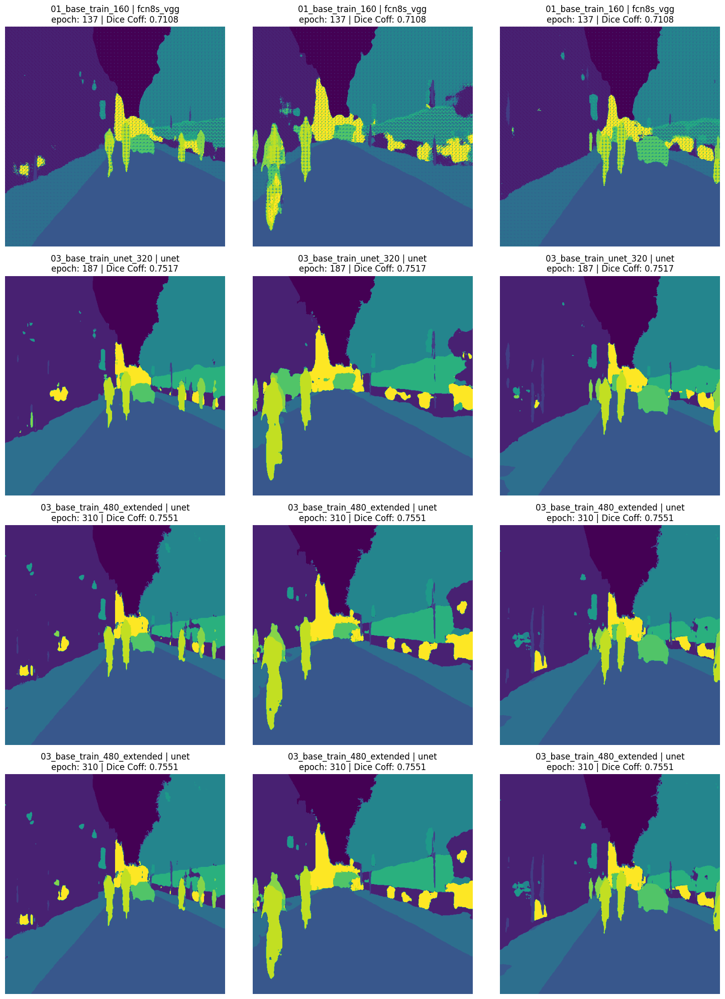

In [109]:
plot_tensors(output_predictions)

In [112]:
!cp -a /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01

In [113]:
!cp -a /content/drive/MyDrive/Experiments/Cp_Model/2024-05-01/02_base_train_120 /content/drive/MyDrive/Experiment/Checkpoint_Model/2024-05-01

In [115]:
!cp -r /content/drive/MyDrive/Experiments/Run_Model/2024-05-01/02_base_train /content/drive/MyDrive/Experiment/Runs_Model/2024-05-01

In [116]:
!cp -r /content/drive/MyDrive/Experiments/Run_Model/2024-05-01/02_base_train_120 /content/drive/MyDrive/Experiment/Runs_Model/2024-05-01

In [117]:
import matplotlib.pyplot as plt

def plot_tensors(outputs):
  # Calculate the total number of plots
  num_dicts = len(outputs)
  num_tensors = len(outputs[0]['tensors'])  # Assuming all dicts have the same number of tensors
  total_plots = num_dicts * num_tensors

  scale = 5
  # Set up the figure size dynamically
  fig, axes = plt.subplots(num_dicts, num_tensors, figsize=(num_tensors * scale, num_dicts * scale))

  # Flatten axes array for easy iteration if there are multiple rows
  if num_dicts > 1:
    axes = axes.flatten()

  # Iterate over each dictionary and each tensor
  for i, output_dict in enumerate(outputs):
    experiment = output_dict['experiment']
    model = output_dict['model']
    best_dice = output_dict['best_dice']
    best_epoch = output_dict['best_epoch']
    for j, tensor in enumerate(output_dict['tensors']):
      ax = axes[i * num_tensors + j]
      ax.imshow(tensor)
      ax.axis(False)
      ax.set_title(f'{experiment} | {model}\nepoch: {best_epoch} | Dice Coff: {1-best_dice:.4f}')

  plt.tight_layout()
  plt.show()


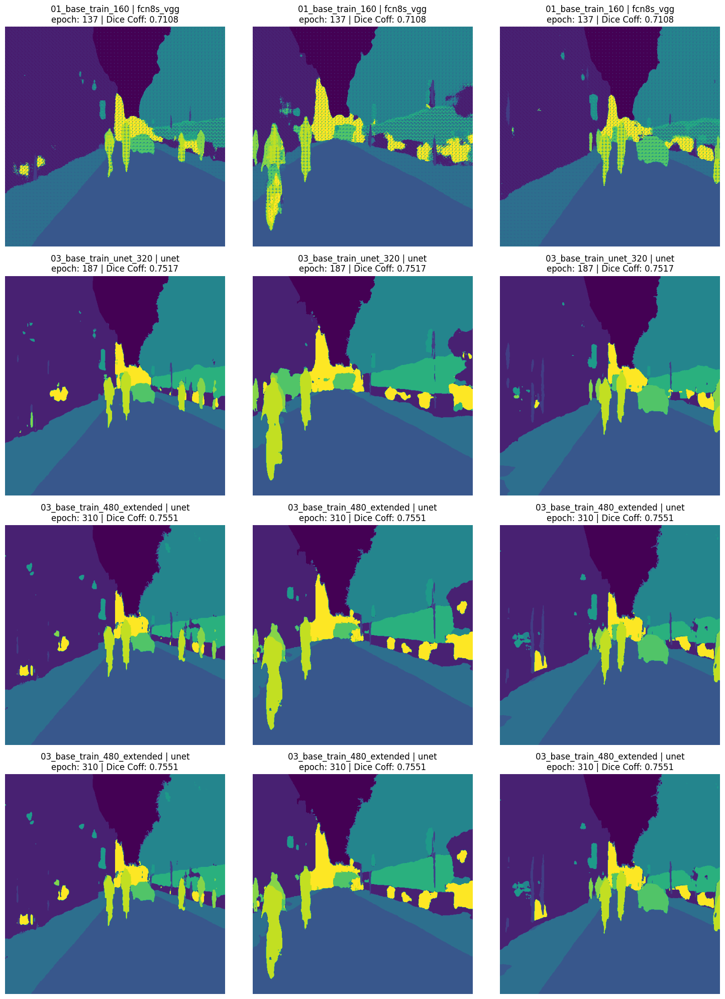

In [118]:
plot_tensors(output_predictions)

In [119]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Experiment/Runs_Model


<IPython.core.display.Javascript object>